# Read the image and transform to dictionary

- Load the image with read_image()
- Show the histogram of grayscale with show_hist_img()
- Plot the image with show_image()
- Map the points in the image with an index with image_point_map()

In [ ]:
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

test_img_path = 'brain.jpeg'

def read_image(path_img):
    """
    Read an image from the specified file path.

    Parameters:
    - path_img (str): The file path to the image.

    Returns:
    - numpy.ndarray: The loaded image represented as a NumPy array.

    Example:
    >>> image_path = "path/to/your/image.jpg"
    >>> result = read_image(image_path)
    >>> print(result)
    [[120 122 125 ...]
     [121 123 126 ...]
     [122 124 127 ...]
     ...
    ]

    Explanation:
    - The function uses OpenCV (cv2) to read an image from the specified file path.
    - The image is returned as a NumPy array.

    """
    # Load an image from file
    image = cv2.imread(path_img, cv2.IMREAD_GRAYSCALE)
    return image

def show_hist_img(img):
    """
    Display the histogram of an image.

    Parameters:
    - img (numpy.ndarray): The input image represented as a NumPy array.

    Example:
    >>> import numpy as np
    >>> image = np.array([[1, 2, 3], [4, 5, 6]])
    >>> show_hist_img(image)

    Explanation:
    - The function calculates the histogram of the input image and plots it using Matplotlib.
    - The x-axis represents pixel intensity, and the y-axis represents frequency.

    """
    # Calculate the histogram
    histogram, bin_edges = np.histogram(img.flatten(), bins=256, range=[0,256])

    # Plot the histogram
    plt.figure(figsize=(10, 5))
    plt.plot(histogram, color='black')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.title('Image Histogram')
    plt.grid(True)
    plt.show()

def show_image(img):
    """
    Display an image.

    Parameters:
    - img (numpy.ndarray): The input image represented as a NumPy array.

    Example:
    >>> import numpy as np
    >>> image = np.array([[1, 2, 3], [4, 5, 6]])
    >>> show_image(image)

    Explanation:
    - The function uses Matplotlib to display the input image.
    - The colormap is set to "gray" for grayscale images.

    """
    plt.imshow(img, cmap="gray")
    plt.show()


img_test = read_image(test_img_path)
show_image(img_test)
show_hist_img(img_test)

In [ ]:
def img_point_map(img):
    """
    Convert an image into a dictionary representing the mapping of pixel indices to their (x, y) positions.

    Parameters:
    - img (numpy.ndarray): The input image represented as a NumPy array.

    Returns:
    - dict: A dictionary where keys are pixel indices, and values are tuples representing (x, y) positions of the pixels.

    Example:
    >>> import numpy as np
    >>> image = np.array([[1, 2, 3],
    ...                   [4, 5, 6],
    ...                   [7, 8, 9]])
    >>> result = img_point_map(image)
    >>> print(result)
    {0: (0, 0), 1: (0, 1), 2: (0, 2), 3: (1, 0), 4: (1, 1), 5: (1, 2), 6: (2, 0), 7: (2, 1), 8: (2, 2)}

    Explanation:
    - For a 3x3 image, the function generates a dictionary where each key is the linear index of a pixel,
      and the corresponding value is a tuple representing the (row, column) position of that pixel in the image.
    """
    image_point_map = {}
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            key = (i * img.shape[1]) + j
            value = (i, j)
            image_point_map[key] = value
    return image_point_map



In [ ]:
def get_point_value(index, image, image_point_map):
    """
    Retrieve the pixel value from an image based on the given pixel index and the corresponding image_point_map.

    Parameters:
    - index (int): The linear index representing the position of the pixel in the image.
    - image (numpy.ndarray): The input image represented as a NumPy array.
    - image_point_map (dict): A dictionary mapping pixel indices to their (x, y) positions in the image.

    Returns:
    - int: The pixel value at the specified index in the image.

    Example:
    >>> import numpy as np
    >>> image = np.array([[1, 2, 3],
    ...                   [4, 5, 6],
    ...                   [7, 8, 9]])
    >>> image_point_map = {0: (0, 0), 1: (0, 1), 2: (0, 2), 3: (1, 0), 4: (1, 1), 5: (1, 2), 6: (2, 0), 7: (2, 1), 8: (2, 2)}
    >>> result = get_point_value(4, image, image_point_map)
    >>> print(result)
    5

    Explanation:
    - The function takes a pixel index (e.g., 4) and uses the image_point_map to retrieve the (x, y) position of the pixel.
    - It then returns the pixel value at that position in the given image.
    """
    return image[image_point_map[index][0]][image_point_map[index][1]]



In [ ]:
image_point_map_test = img_point_map(img_test)
print(get_point_value(1, img_test, image_point_map_test))

# Create the Matrix of degree membership

In [ ]:
def initialize_membership(image, clusters, type):
    """
    Initialize the membership degree matrix for fuzzy clustering algorithms.

    Parameters:
    - image (numpy.ndarray): The input image represented as a NumPy array.
    - clusters (int): The number of clusters to be formed.
    - type (str): The type of initialization to be performed. Supported values are "alea" (random) and "zeros".

    Returns:
    - pandas.DataFrame: The membership degree matrix with rows representing pixels and columns representing clusters.

    Example:
    >>> import numpy as np
    >>> result = initialize_membership(np.array([[1, 2], [3, 4]]), 2, "alea")
    >>> print(result)
             1         2
    0  0.611905  0.388095
    1  0.263158  0.736842

    Explanation:
    - For a 2x2 image and 2 clusters, the function initializes a membership degree matrix.
    - If type is "alea," it fills the matrix with random values normalized along each row.
    - If type is "zeros," it initializes the matrix with zeros.

    Note: Ensure the sum of each row in the membership matrix is 1 for "alea" type.

    """
    # number of steps
    num_rows = image.shape[0] * image.shape[1]
    # number of clusters 
    num_cols, clusters = (clusters, clusters)
    if type == "alea":
        data = np.random.rand(num_rows, int(num_cols))
        data = data / data.sum(axis=1, keepdims=True)
    elif type == "zeros":
        data = np.zeros((num_rows, num_cols))
    # membership degree matrix
    membership = pd.DataFrame(data, columns=[str(x + 1) for x in range(clusters)])
    return membership

In [ ]:
membership = initialize_membership(img_test, 2, 'alea')
display(membership)

# Function to calculate the centers vectors

In [ ]:
def compute_center_vector(membership_matrix, image, image_point_map): 
    """
    Compute the center vectors for fuzzy clustering based on the given membership matrix and image.

    Parameters:
    - membership_matrix (pandas.DataFrame): The membership degree matrix with rows representing pixels and columns representing clusters.
    - image (numpy.ndarray): The input image represented as a NumPy array.
    - image_point_map (dict): A dictionary mapping pixel indices to their (x, y) positions in the image.

    Returns:
    - numpy.ndarray: The computed center vectors for each cluster.

    Example:
    >>> import numpy as np
    >>> import pandas as pd
    >>> membership_matrix = pd.DataFrame({"1": [0.5, 0.3, 0.2], "2": [0.1, 0.7, 0.2]})
    >>> image = np.array([[1, 2], [3, 4], [5, 6]])
    >>> image_point_map = {0: (0, 0), 1: (0, 1), 2: (1, 0)}
    >>> result = compute_center_vector(membership_matrix, image, image_point_map)
    >>> print(result)
    array([2.65, 3.8])

    Explanation:
    - For a membership matrix and an image, the function computes the center vectors for each cluster.
    - The center vectors represent the average values of pixels in the respective clusters.

    """
    U = membership_matrix.values
    X = []

    for index in membership_matrix.index.values:
        X.append(get_point_value(index, image, image_point_map))

    centers = U.T @ X / np.sum(U.T, axis=1)
    return centers

In [ ]:
# centers_vectors = [13, 57]
print(compute_center_vector(membership, img_test, image_point_map_test))

# Function to update the membership matrix

In [ ]:
import math
from tqdm import tqdm
from scipy.spatial.distance import cdist

def update_membership(membership, centers, m, image, image_point_map):
    """
    Update the membership degree matrix for fuzzy clustering based on the given centers and image.

    Parameters:
    - membership (pandas.DataFrame): The current membership degree matrix with rows representing pixels and columns representing clusters.
    - centers (numpy.ndarray): The center vectors for each cluster.
    - m (float): The fuzziness parameter controlling the degree of cluster fuzziness.
    - image (numpy.ndarray): The input image represented as a NumPy array.
    - image_point_map (dict): A dictionary mapping pixel indices to their (x, y) positions in the image.

    Returns:
    - pandas.DataFrame: The updated membership degree matrix.

    Example:
    >>> import numpy as np
    >>> import pandas as pd
    >>> membership_matrix = pd.DataFrame({"1": [0.5, 0.3, 0.2], "2": [0.1, 0.7, 0.2]})
    >>> centers = np.array([[2.5, 3.5], [4.5, 5.5]])
    >>> m = 2
    >>> image = np.array([[1, 2], [3, 4], [5, 6]])
    >>> image_point_map = {0: (0, 0), 1: (0, 1), 2: (1, 0)}
    >>> result = update_membership(membership_matrix, centers, m, image, image_point_map)
    >>> print(result)
             1         2
    0  0.693878  0.306122
    1  0.079051  0.920949
    2  0.990918  0.009082

    Explanation:
    - The function updates the membership matrix using the specified fuzziness parameter (m) and the new center vectors.
    - It employs the fuzzy c-means algorithm to adjust the membership degrees based on the distances between pixels and cluster centers.

    """
    membership_copied = membership.copy(deep=True)

    for index in tqdm(membership_copied.index.values):
        point = get_point_value(index, image, image_point_map)
        for i in range(len(centers)):
            den = 0
            for center in centers:
                den += (np.linalg.norm(point - centers[i]) / np.linalg.norm(point - center)) ** (2 / (m - 1))
            membership_copied[str(i + 1)][index] = 1 / den
    return membership_copied


In [ ]:
centers_vectors = [13.6, 57.6]
new_membership = update_membership(membership, centers_vectors, 3, img_test, image_point_map_test)
new_membership


# Show result of new membership image

In [ ]:
def visualize_fuzzy_k_means_result(membership, centers, m, original_image, image_point_map):
    """
    Visualize the result of Fuzzy K-Means clustering.

    Parameters:
    - membership: Resulting membership values from Fuzzy K-Means (DataFrame).
    - centers: Cluster centers obtained from Fuzzy K-Means.
    - m: Fuzziness parameter.
    - original_image: Original image for reference.

    Returns:
    - None (displays the plot).
    """
    num_clusters = len(centers)

    # Extract data points from membership DataFrame
    data = np.array([[image_point_map[i][0], image_point_map[i][1]] for i in membership.index.values])

    # Assign colors based on membership values
    colors = np.argmax(membership.values, axis=1)

    # Rotate the data by a specified angle (in degrees)
    angle_degrees = -90
    theta = np.radians(angle_degrees)
    rotated_x = data[:, 0] * np.cos(theta) - data[:, 1] * np.sin(theta)
    rotated_y = data[:, 0] * np.sin(theta) + data[:, 1] * np.cos(theta)

    plt.figure(figsize=(14, 6))

    # Plot original image
    plt.subplot(1, 2, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    # Plot segmented image
    plt.subplot(1, 2, 2)
    plt.scatter(rotated_x, rotated_y, c=colors, cmap='viridis', alpha=0.5)
    plt.title(f'Fuzzy K-Means Clustering Result (m={m})')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.legend()

    plt.show()

In [ ]:
visualize_fuzzy_k_means_result(membership, centers_vectors, 2, img_test, image_point_map_test)

# Compute the distance between the two membership matrix

In [ ]:
def distance(old, new):
    return np.linalg.norm(new - old)

In [ ]:
print(distance(new_membership, membership))

# Putting it all together

======> Preparing data...


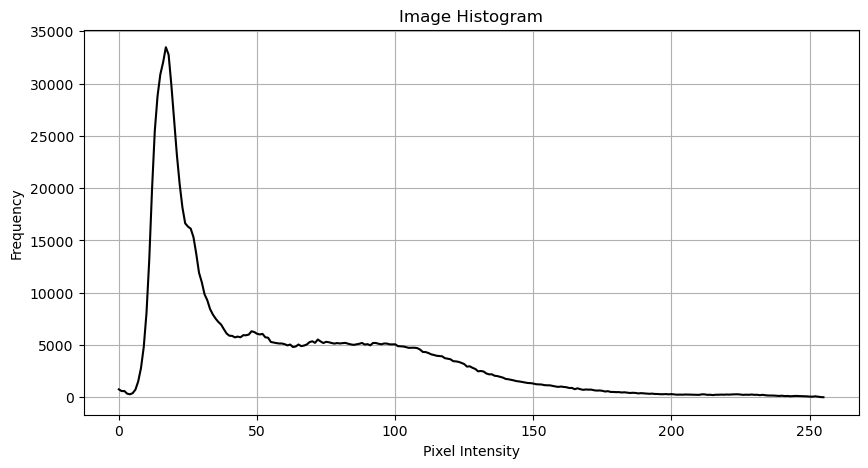


************** Step 1 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [05:45<00:00, 3037.28it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


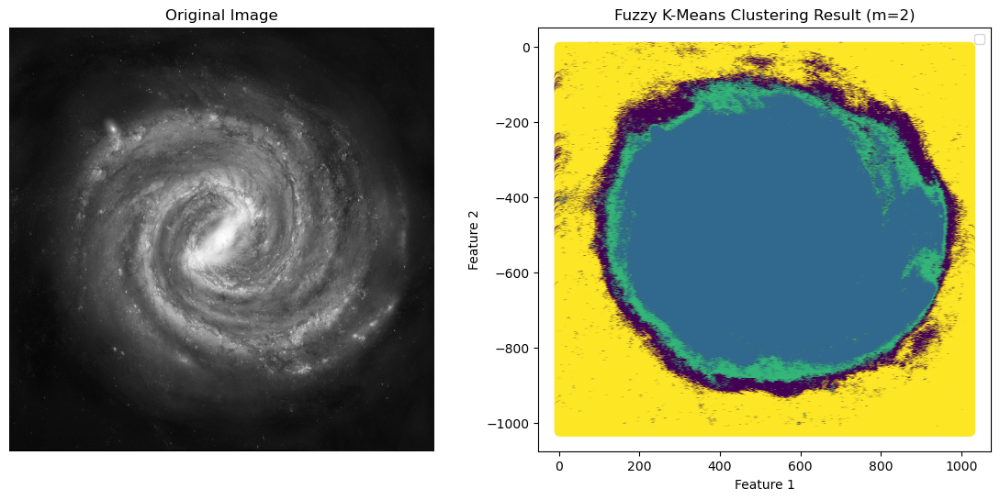

Done updating membership
## Showing result for 10000 - old; (0.0,0.0),new: (0.19912889555874924,0.021510454286912676)

======> Computing centers...
Old centers: [30.56, 60.3, 45.5, 23.6]
New centers: [49.72428804 88.01851502 74.44482903 31.44104868]
======> Computing distance between old and new degree of membership matrices...
Distance at step 1: 776.3136595694886
======> Checking stopping condition

************** Step 2 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2815.32it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


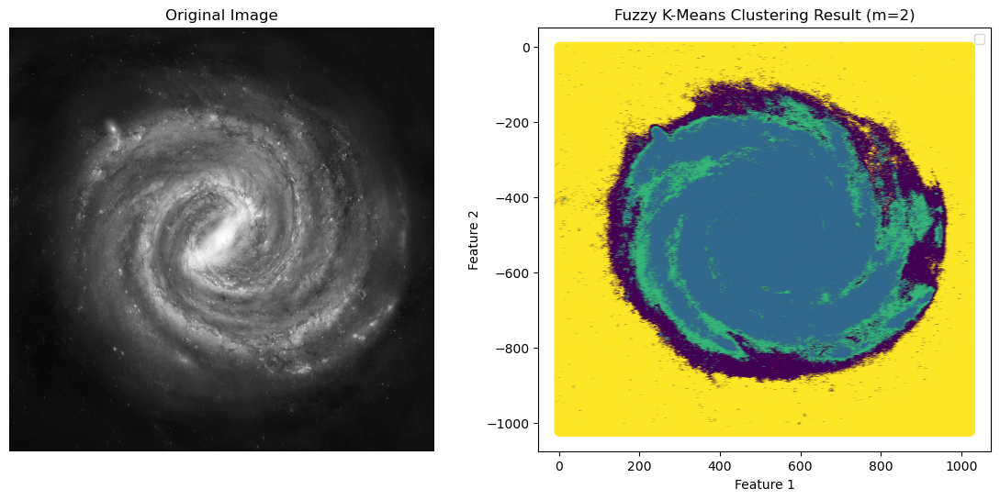

Done updating membership
## Showing result for 10000 - old; (0.19912889555874924,0.021510454286912676),new: (0.15816804238381882,0.03468294721899419)

======> Computing centers...
Old centers: [49.72428804 88.01851502 74.44482903 31.44104868]
New centers: [ 52.71065862 103.21017247  85.45138234  27.10725344]
======> Computing distance between old and new degree of membership matrices...
Distance at step 2: 668.9310812945537
======> Checking stopping condition


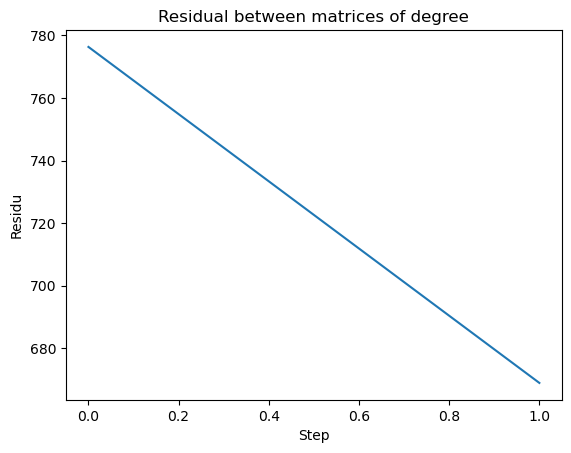


************** Step 3 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:14<00:00, 2800.94it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


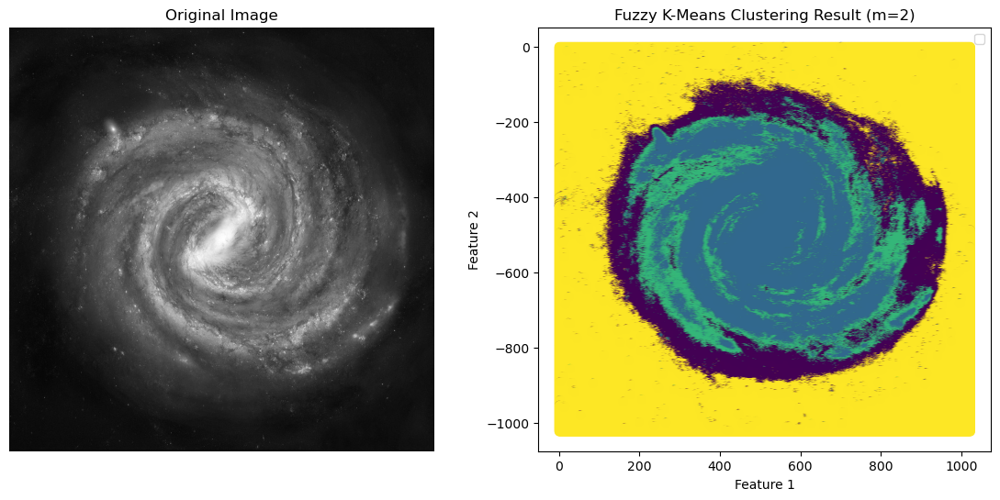

Done updating membership
## Showing result for 10000 - old; (0.15816804238381882,0.03468294721899419),new: (0.08077333833798928,0.014312585503008237)

======> Computing centers...
Old centers: [ 52.71065862 103.21017247  85.45138234  27.10725344]
New centers: [ 55.77331299 114.82179557  91.44542852  24.48657108]
======> Computing distance between old and new degree of membership matrices...
Distance at step 3: 366.0840054448758
======> Checking stopping condition


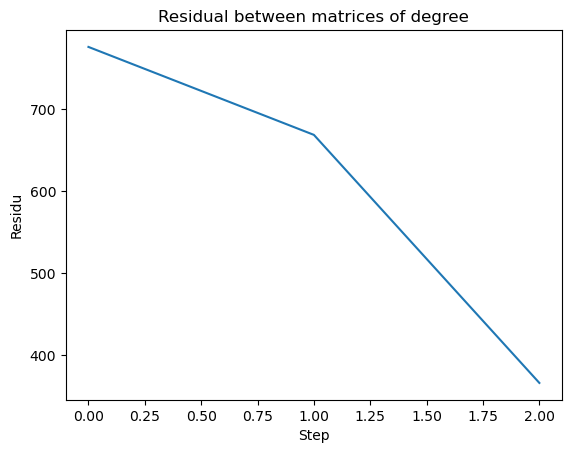


************** Step 4 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:16<00:00, 2784.43it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


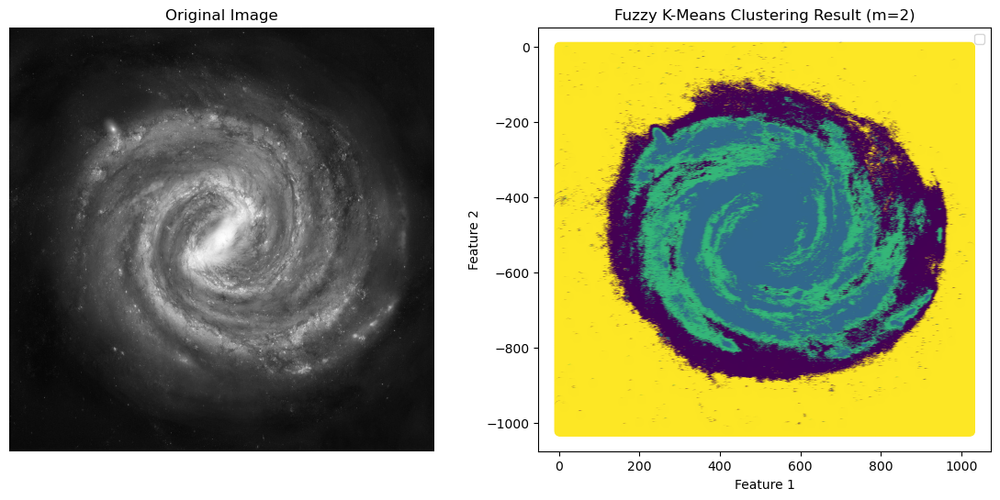

Done updating membership
## Showing result for 10000 - old; (0.08077333833798928,0.014312585503008237),new: (0.04272721133741819,0.00692121918894707)

======> Computing centers...
Old centers: [ 55.77331299 114.82179557  91.44542852  24.48657108]
New centers: [ 58.07627875 123.04381412  94.09545723  23.52989501]
======> Computing distance between old and new degree of membership matrices...
Distance at step 4: 244.95956725317043
======> Checking stopping condition


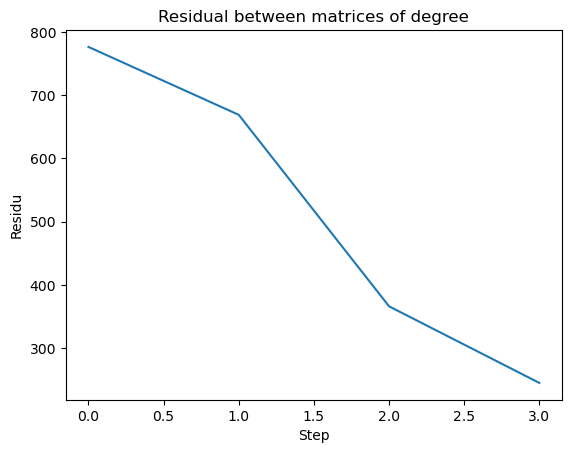


************** Step 5 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2818.52it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


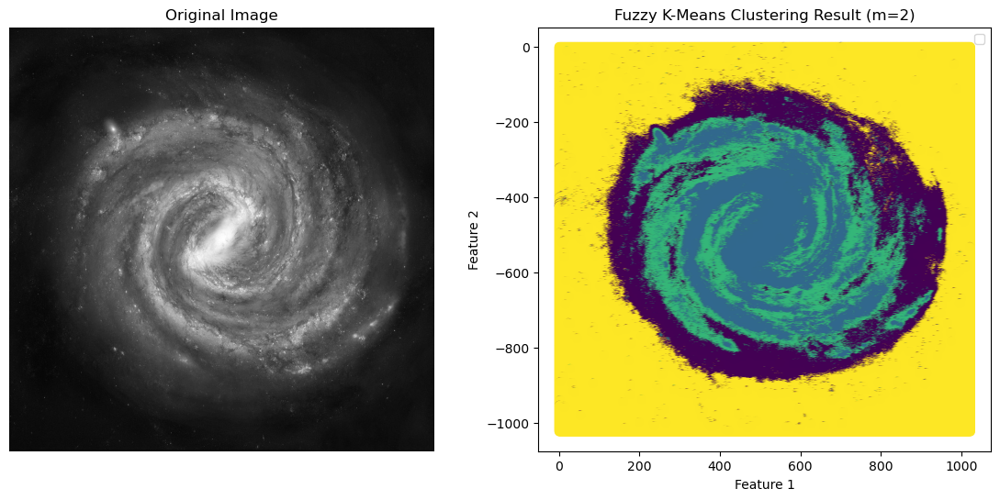

Done updating membership
## Showing result for 10000 - old; (0.04272721133741819,0.00692121918894707),new: (0.030609696275305184,0.004729448679473463)

======> Computing centers...
Old centers: [ 58.07627875 123.04381412  94.09545723  23.52989501]
New centers: [ 59.39726762 128.45989915  95.33611894  23.26289422]
======> Computing distance between old and new degree of membership matrices...
Distance at step 5: 137.0740793326563
======> Checking stopping condition


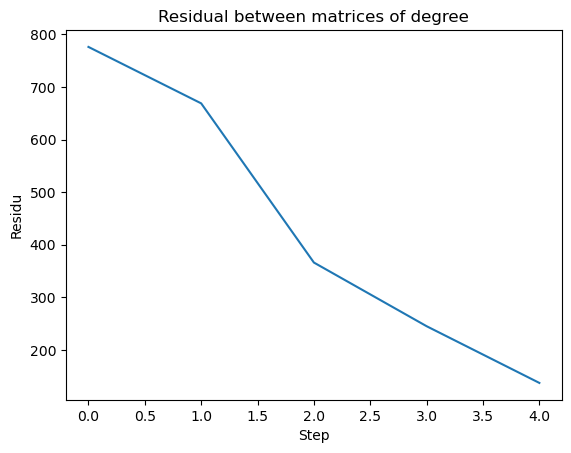


************** Step 6 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2810.66it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


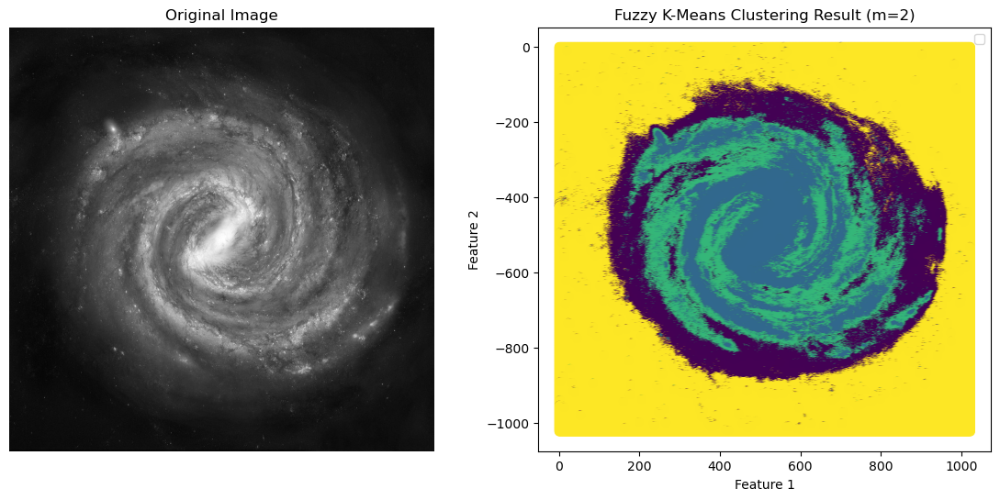

Done updating membership
## Showing result for 10000 - old; (0.030609696275305184,0.004729448679473463),new: (0.026917046930479683,0.004008268493214019)

======> Computing centers...
Old centers: [ 59.39726762 128.45989915  95.33611894  23.26289422]
New centers: [ 60.13007103 131.8523766   96.08501979  23.20436749]
======> Computing distance between old and new degree of membership matrices...
Distance at step 6: 74.93350554907637
======> Checking stopping condition


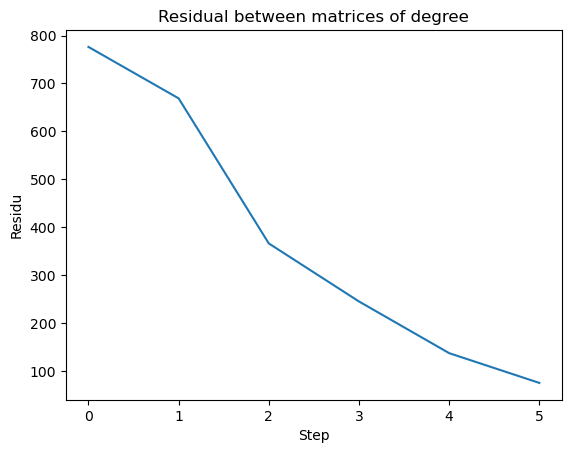


************** Step 7 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2815.82it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


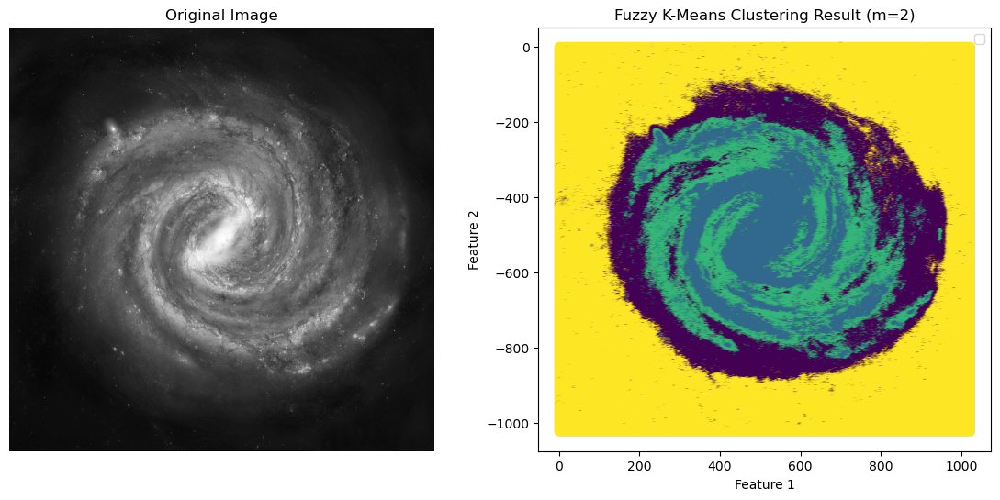

Done updating membership
## Showing result for 10000 - old; (0.026917046930479683,0.004008268493214019),new: (0.025660755912278187,0.0037233066313995954)

======> Computing centers...
Old centers: [ 60.13007103 131.8523766   96.08501979  23.20436749]
New centers: [ 60.56178939 133.92865678  96.62141141  23.2008928 ]
======> Computing distance between old and new degree of membership matrices...
Distance at step 7: 42.994867118279174
======> Checking stopping condition


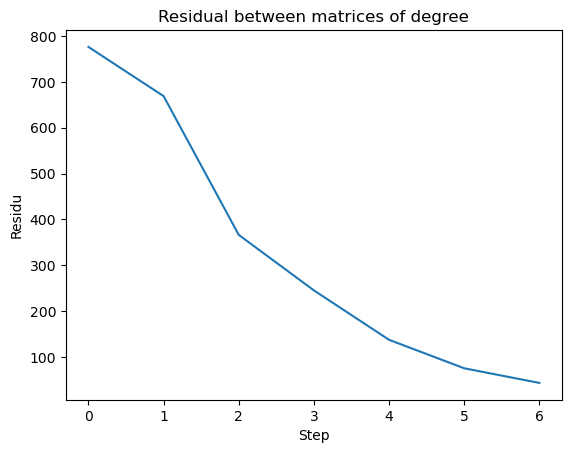


************** Step 8 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2807.89it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


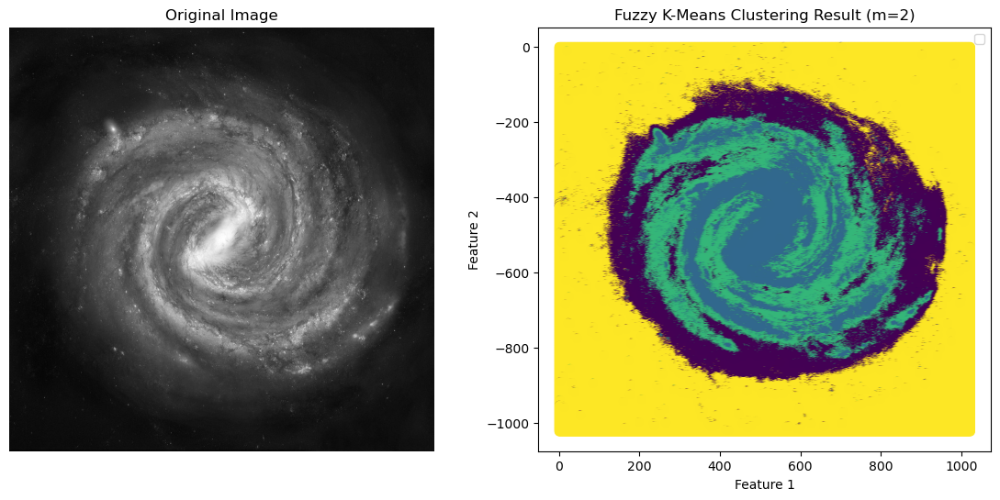

Done updating membership
## Showing result for 10000 - old; (0.025660755912278187,0.0037233066313995954),new: (0.02516089161577954,0.003592630615888832)

======> Computing centers...
Old centers: [ 60.56178939 133.92865678  96.62141141  23.2008928 ]
New centers: [ 60.83664692 135.19465857  97.0214408   23.21010484]
======> Computing distance between old and new degree of membership matrices...
Distance at step 8: 25.950153925781954
======> Checking stopping condition


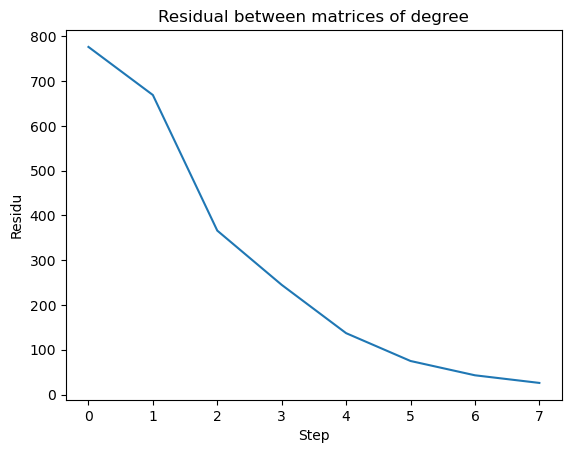


************** Step 9 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:15<00:00, 2790.82it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


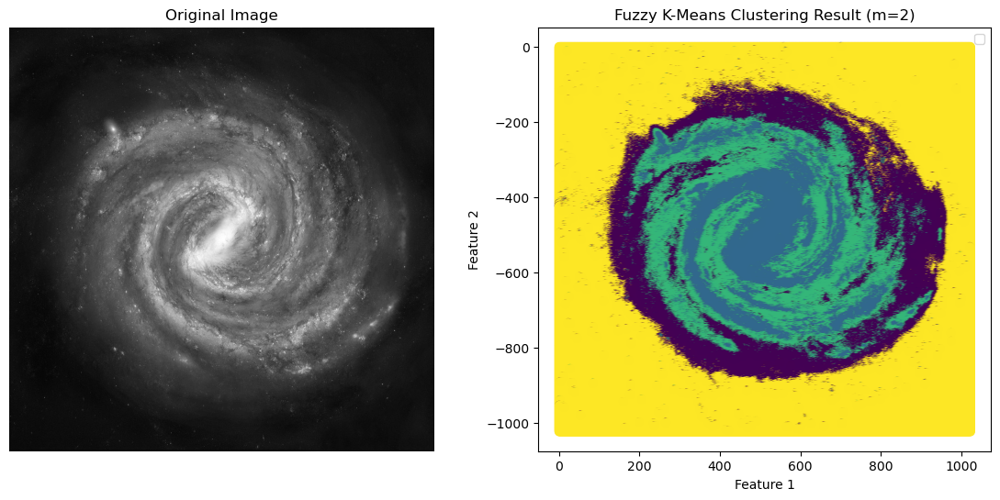

Done updating membership
## Showing result for 10000 - old; (0.02516089161577954,0.003592630615888832),new: (0.02492613370810679,0.003527017266668226)

======> Computing centers...
Old centers: [ 60.83664692 135.19465857  97.0214408   23.21010484]
New centers: [ 61.02299531 135.97149074  97.31648194  23.22091728]
======> Computing distance between old and new degree of membership matrices...
Distance at step 9: 16.295318376206474
======> Checking stopping condition


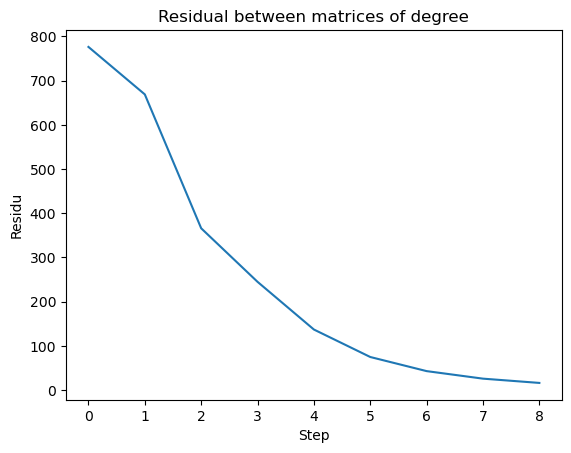


************** Step 10 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2806.01it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


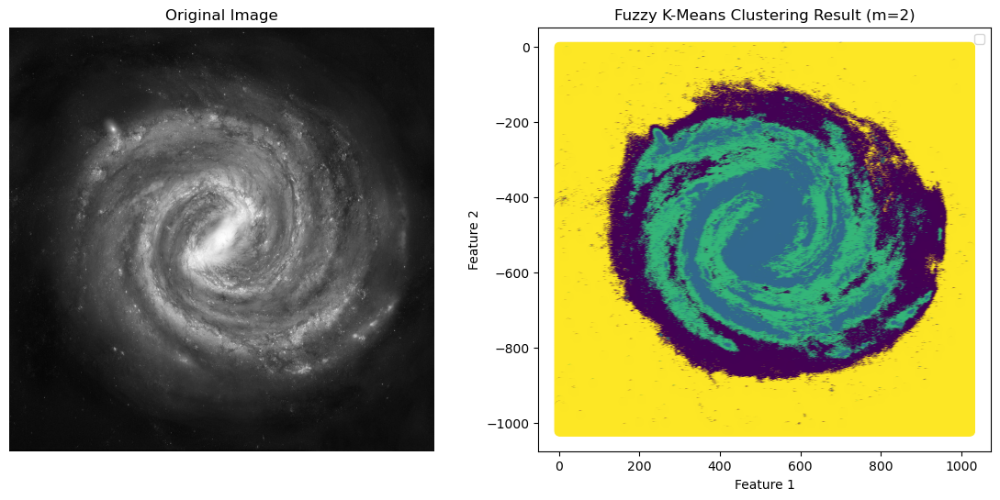

Done updating membership
## Showing result for 10000 - old; (0.02492613370810679,0.003527017266668226),new: (0.024799365241833522,0.003492635173176166)

======> Computing centers...
Old centers: [ 61.02299531 135.97149074  97.31648194  23.22091728]
New centers: [ 61.15454521 136.45308663  97.52975975  23.23058385]
======> Computing distance between old and new degree of membership matrices...
Distance at step 10: 10.528275727356988
======> Checking stopping condition


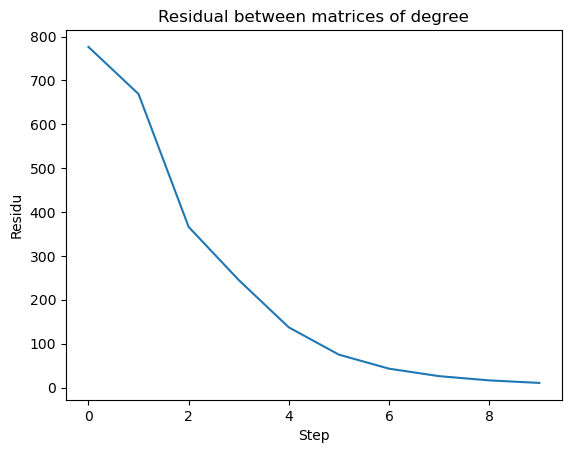


************** Step 11 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2810.23it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


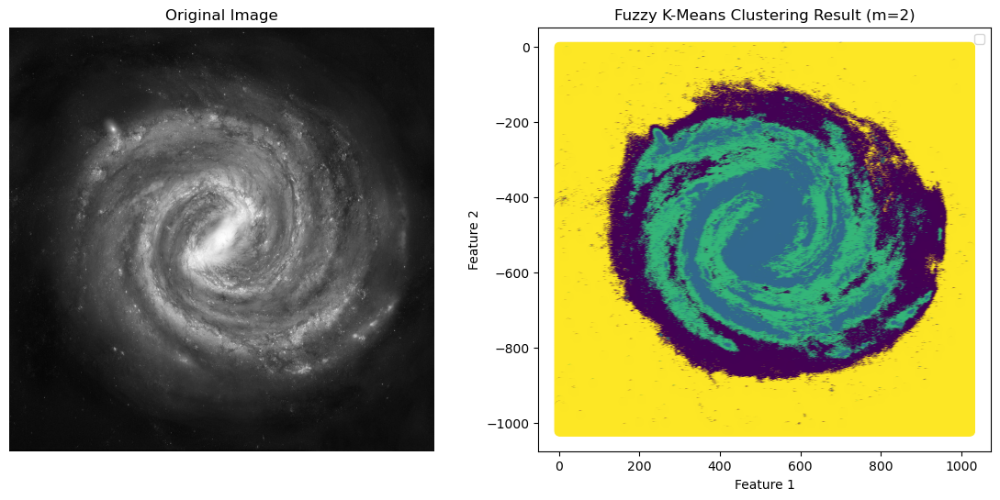

Done updating membership
## Showing result for 10000 - old; (0.024799365241833522,0.003492635173176166),new: (0.024724008634826784,0.003474449188618775)

======> Computing centers...
Old centers: [ 61.15454521 136.45308663  97.52975975  23.23058385]
New centers: [ 61.24941228 136.75498596  97.68131312  23.23855886]
======> Computing distance between old and new degree of membership matrices...
Distance at step 11: 6.937711800434899
======> Checking stopping condition


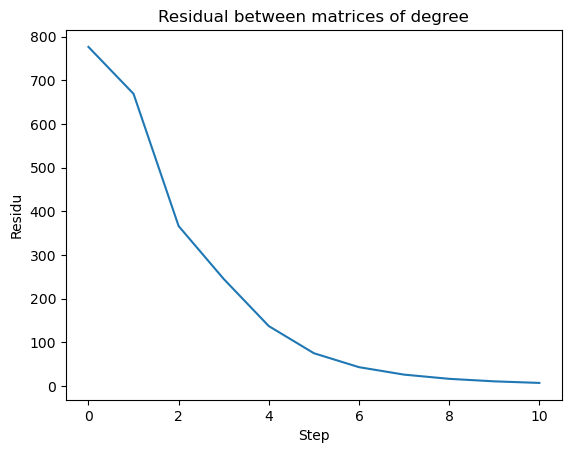


************** Step 12 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2807.88it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


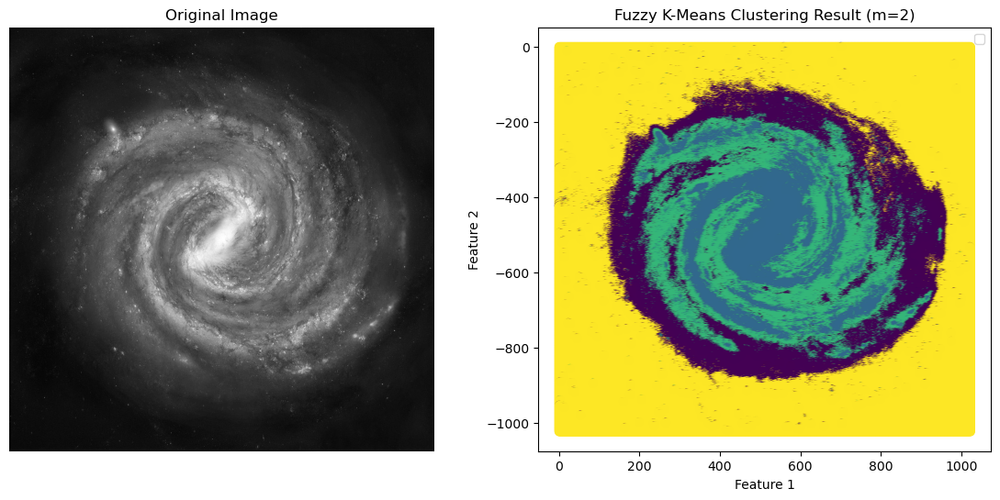

Done updating membership
## Showing result for 10000 - old; (0.024724008634826784,0.003474449188618775),new: (0.02467652492712182,0.0034649721011289314)

======> Computing centers...
Old centers: [ 61.24941228 136.75498596  97.68131312  23.23855886]
New centers: [ 61.31841078 136.94625191  97.78767973  23.24489203]
======> Computing distance between old and new degree of membership matrices...
Distance at step 12: 4.634215140759793
======> Checking stopping condition


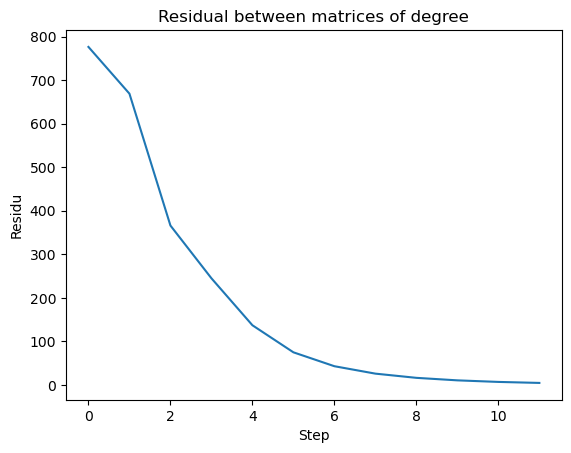


************** Step 13 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:23<00:00, 2736.55it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


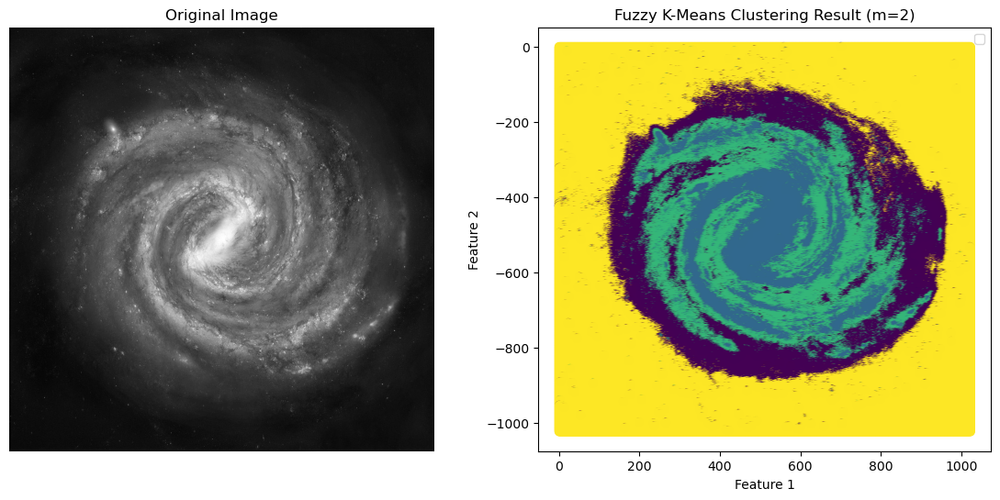

Done updating membership
## Showing result for 10000 - old; (0.02467652492712182,0.0034649721011289314),new: (0.0246455774520153,0.003460218415073263)

======> Computing centers...
Old centers: [ 61.31841078 136.94625191  97.78767973  23.24489203]
New centers: [ 61.36864883 137.0685945   97.86171114  23.24979795]
======> Computing distance between old and new degree of membership matrices...
Distance at step 13: 3.1250605627067545
======> Checking stopping condition


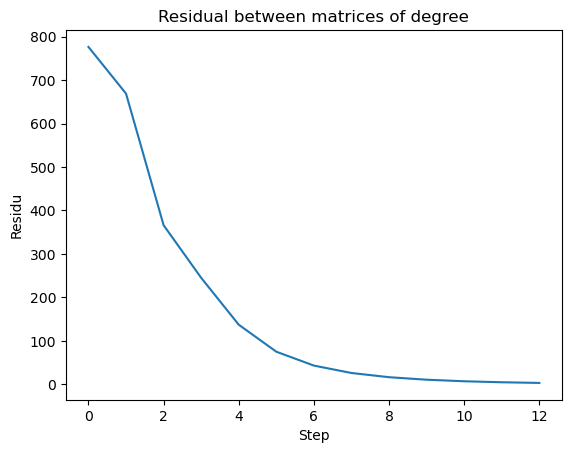


************** Step 14 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:25<00:00, 2716.99it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


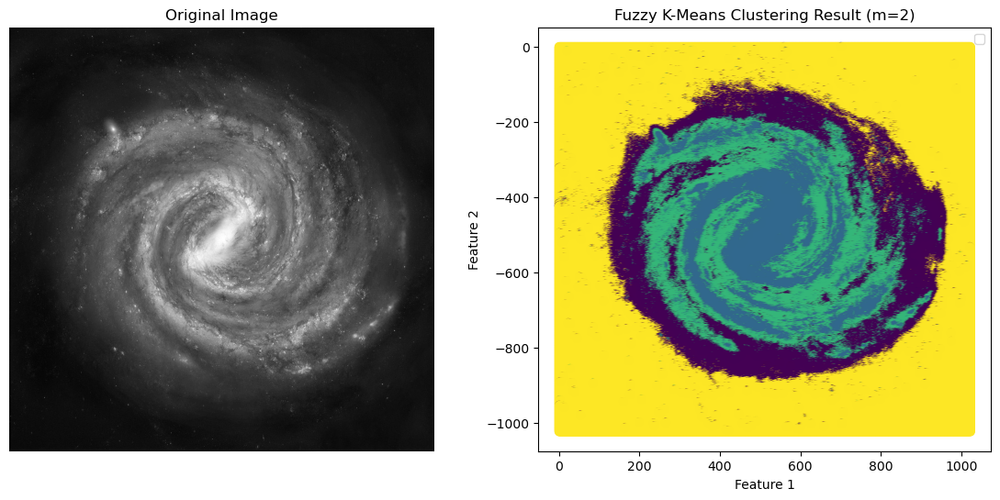

Done updating membership
## Showing result for 10000 - old; (0.0246455774520153,0.003460218415073263),new: (0.024625006043462117,0.003458000365969431)

======> Computing centers...
Old centers: [ 61.36864883 137.0685945   97.86171114  23.24979795]
New centers: [ 61.40512662 137.14752011  97.91296004  23.25352675]
======> Computing distance between old and new degree of membership matrices...
Distance at step 14: 2.121644715134062
======> Checking stopping condition


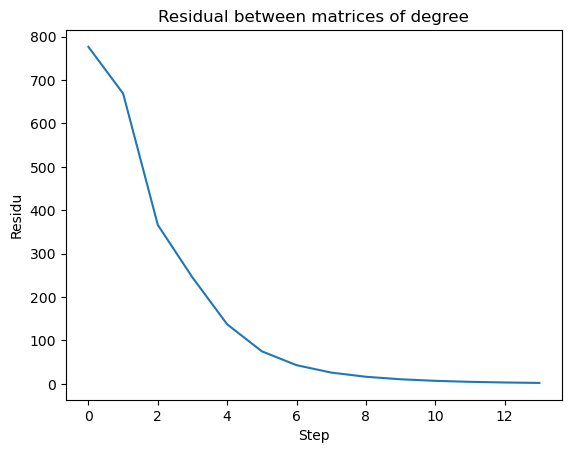


************** Step 15 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:24<00:00, 2724.96it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


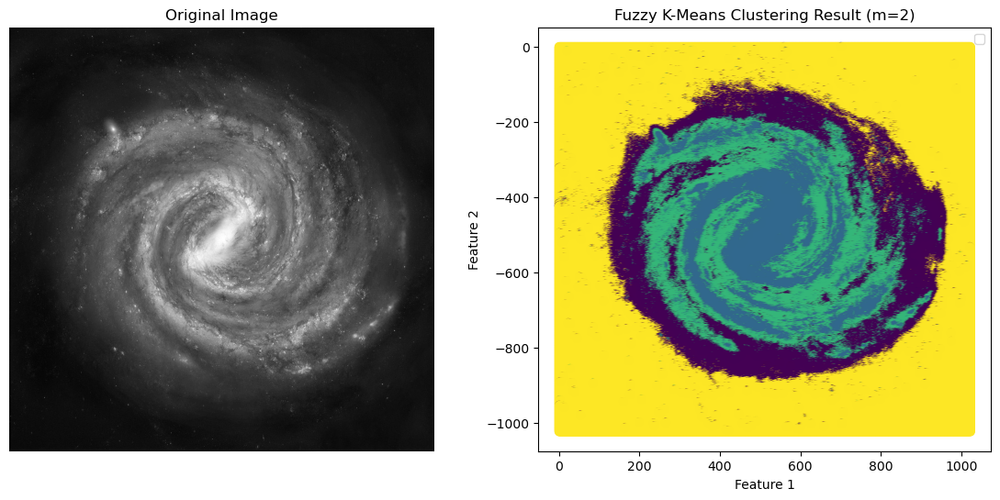

Done updating membership
## Showing result for 10000 - old; (0.024625006043462117,0.003458000365969431),new: (0.024611167650199738,0.003457107974796502)

======> Computing centers...
Old centers: [ 61.40512662 137.14752011  97.91296004  23.25352675]
New centers: [ 61.43149532 137.19882142  97.94831949  23.2563175 ]
======> Computing distance between old and new degree of membership matrices...
Distance at step 15: 1.4474454854800871
======> Checking stopping condition


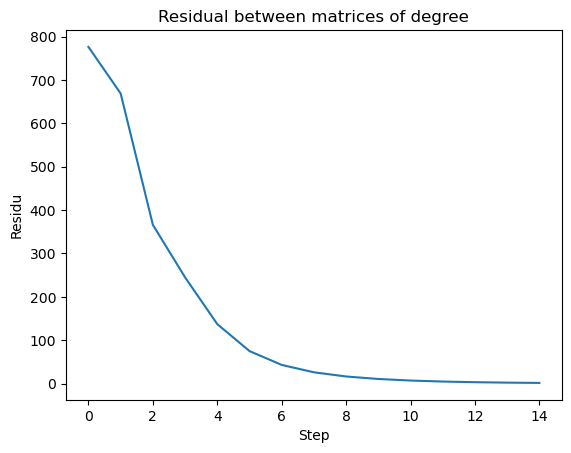


************** Step 16 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:11<00:00, 2821.94it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


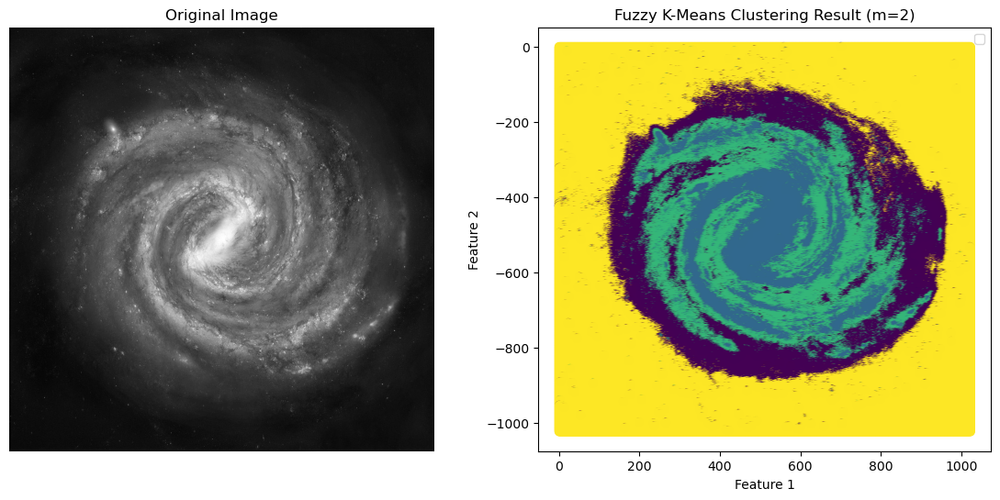

Done updating membership
## Showing result for 10000 - old; (0.024611167650199738,0.003457107974796502),new: (0.024601787877958966,0.003456877094654197)

======> Computing centers...
Old centers: [ 61.43149532 137.19882142  97.94831949  23.2563175 ]
New centers: [ 61.45046168 137.23238999  97.97266862  23.25837972]
======> Computing distance between old and new degree of membership matrices...
Distance at step 16: 0.9909944933532169
======> Checking stopping condition


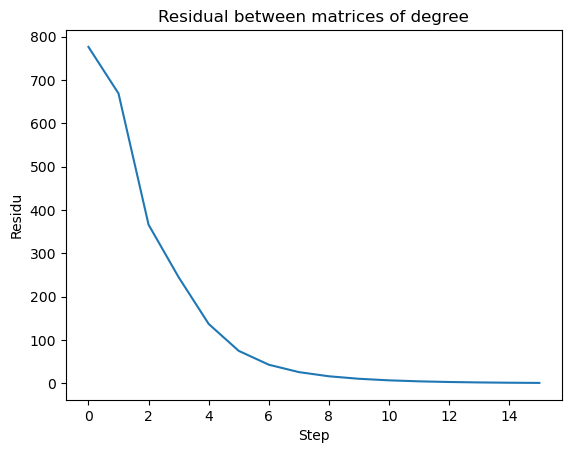


************** Step 17 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:15<00:00, 2791.25it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


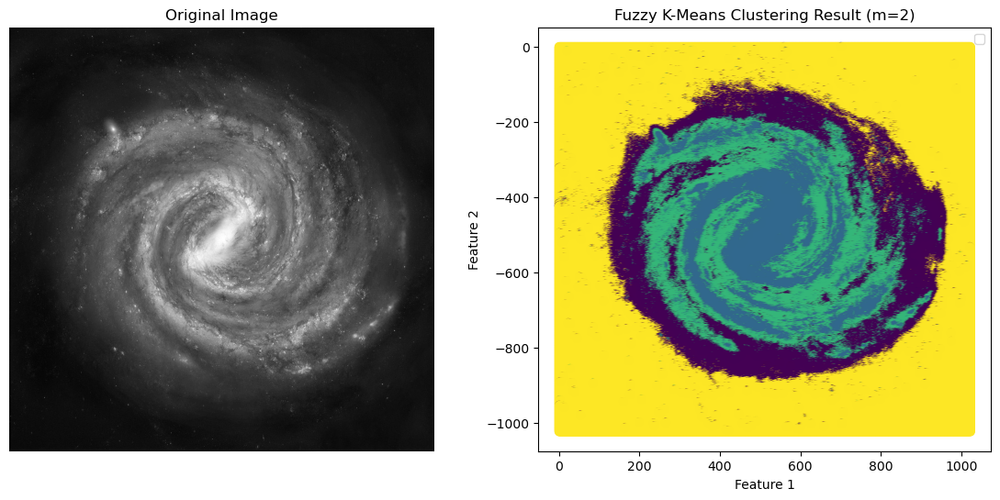

Done updating membership
## Showing result for 10000 - old; (0.024601787877958966,0.003456877094654197),new: (0.02459539825909216,0.003456950201049964)

======> Computing centers...
Old centers: [ 61.45046168 137.23238999  97.97266862  23.25837972]
New centers: [ 61.46403687 137.25448572  97.98941872  23.25988755]
======> Computing distance between old and new degree of membership matrices...
Distance at step 17: 0.6802446833053267
======> Checking stopping condition


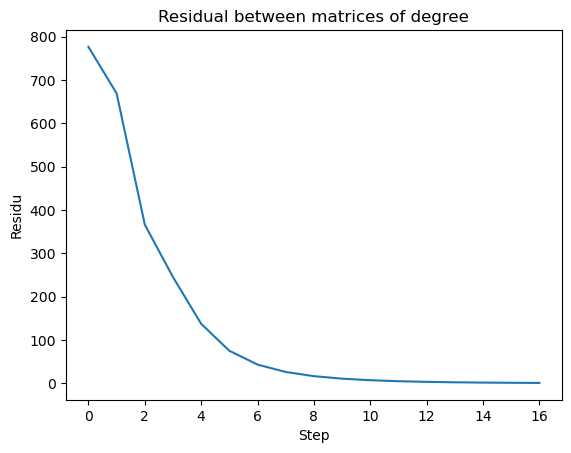


************** Step 18 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2814.67it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


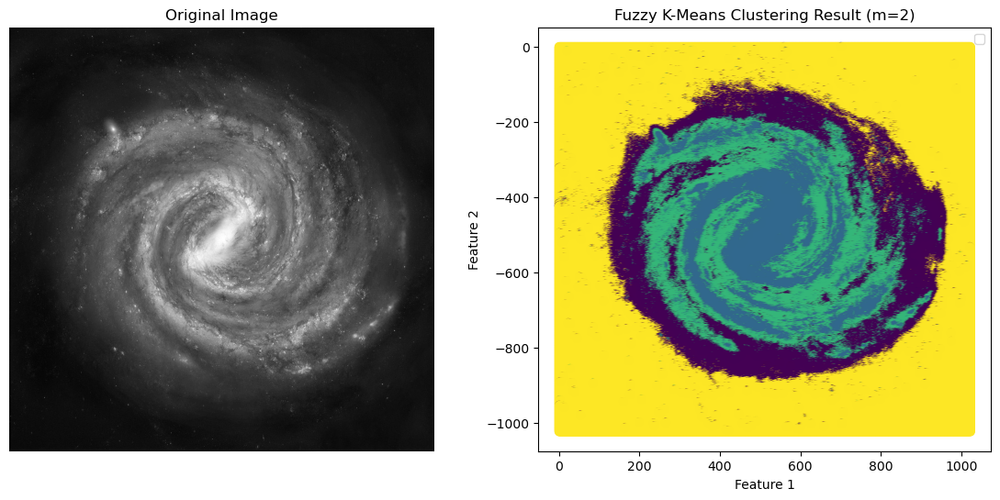

Done updating membership
## Showing result for 10000 - old; (0.02459539825909216,0.003456950201049964),new: (0.024591030531580897,0.00345714099076434)

======> Computing centers...
Old centers: [ 61.46403687 137.25448572  97.98941872  23.25988755]
New centers: [ 61.47370914 137.26910674  98.00093643  23.26098035]
======> Computing distance between old and new degree of membership matrices...
Distance at step 18: 0.4678231884742183
======> Checking stopping condition


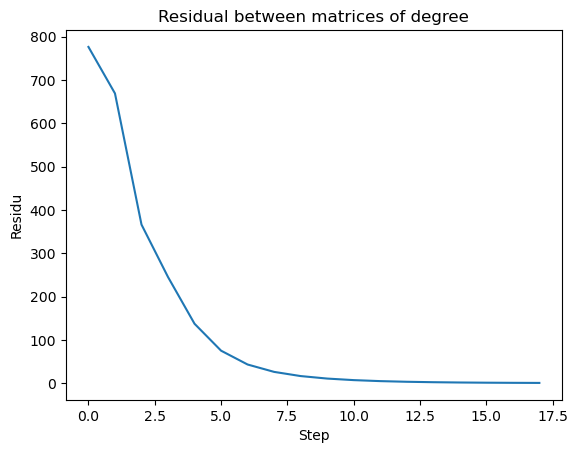


************** Step 19 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2809.14it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


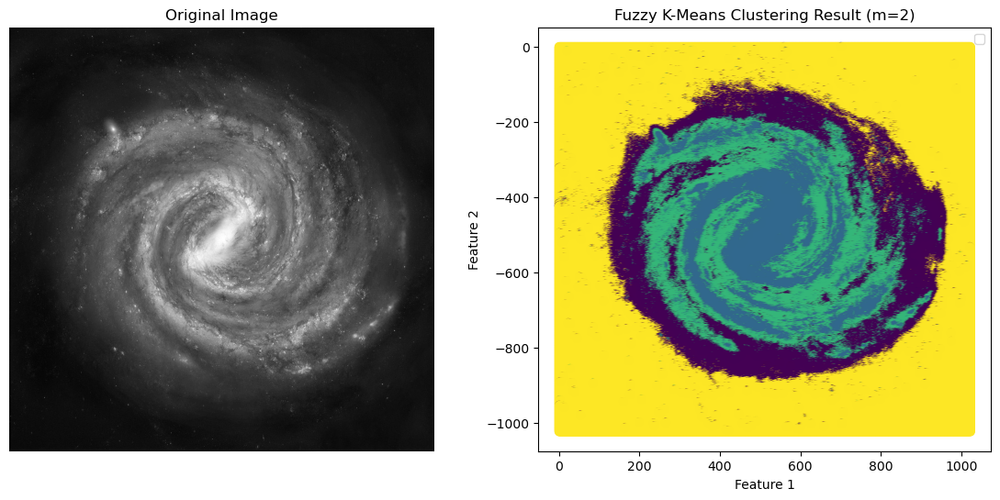

Done updating membership
## Showing result for 10000 - old; (0.024591030531580897,0.00345714099076434),new: (0.02458803757313738,0.003457357349991453)

======> Computing centers...
Old centers: [ 61.47370914 137.26910674  98.00093643  23.26098035]
New centers: [ 61.48057246 137.27882753  98.00885583  23.26176657]
======> Computing distance between old and new degree of membership matrices...
Distance at step 19: 0.32218056092982594
======> Checking stopping condition


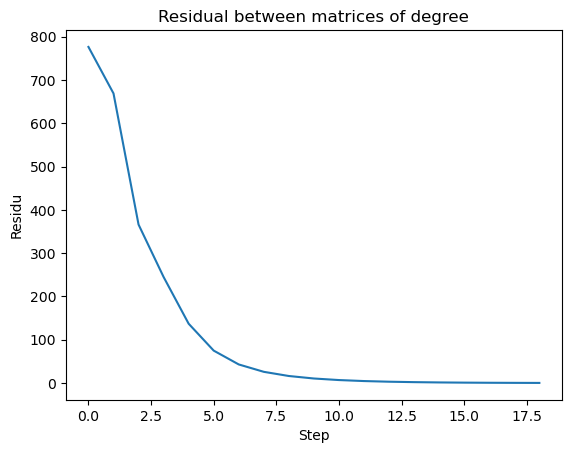


************** Step 20 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:15<00:00, 2792.51it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


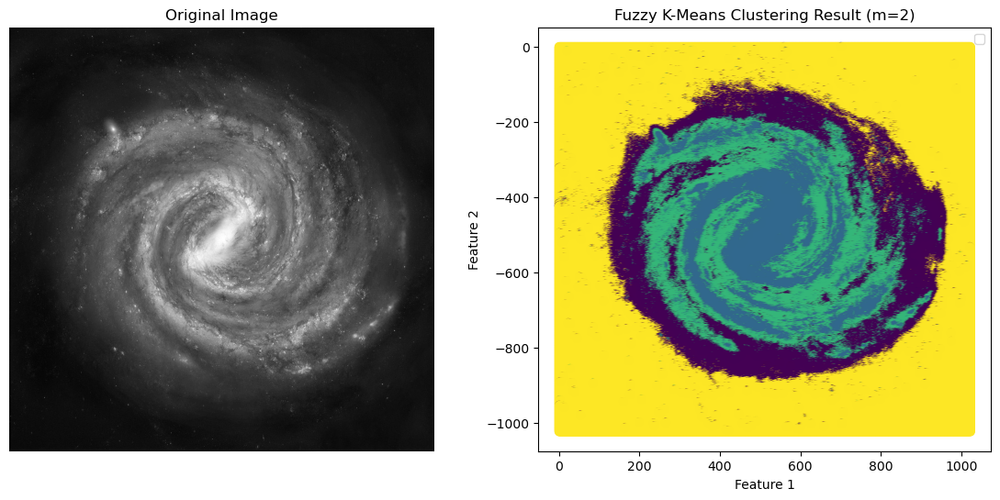

Done updating membership
## Showing result for 10000 - old; (0.02458803757313738,0.003457357349991453),new: (0.02458598299608207,0.0034575577478154875)

======> Computing centers...
Old centers: [ 61.48057246 137.27882753  98.00885583  23.26176657]
New centers: [ 61.48542504 137.28531792  98.01430203  23.26232875]
======> Computing distance between old and new degree of membership matrices...
Distance at step 20: 0.22210327239618693
======> Checking stopping condition


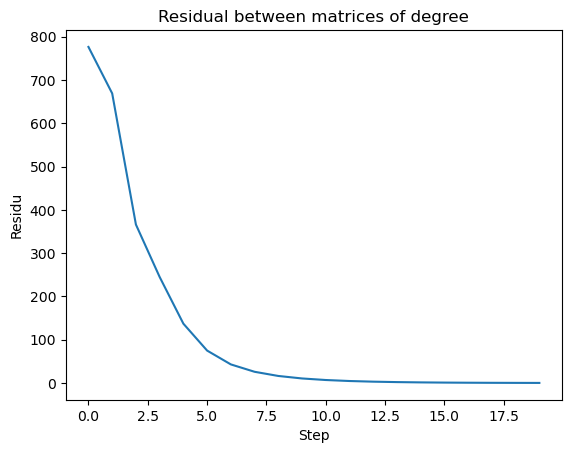


************** Step 21 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:16<00:00, 2787.70it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


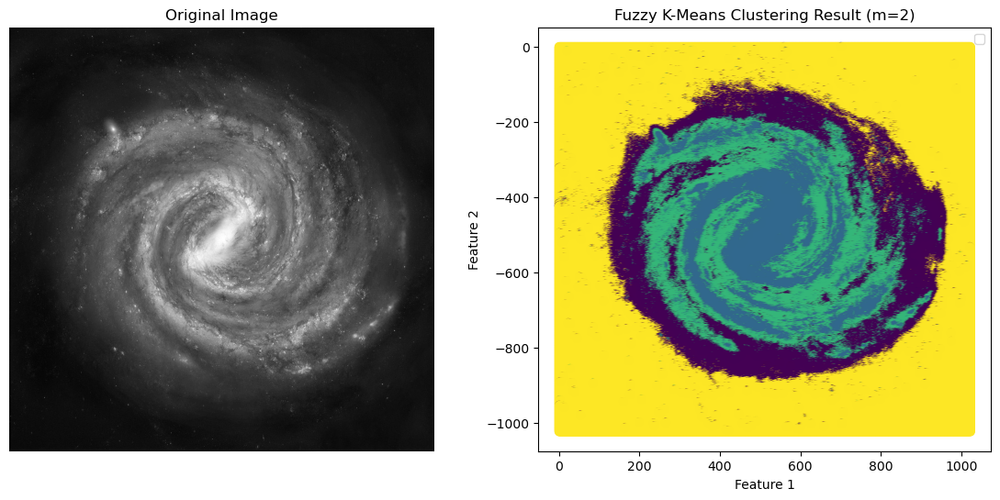

Done updating membership
## Showing result for 10000 - old; (0.02458598299608207,0.0034575577478154875),new: (0.02458457070845068,0.003457726846179318)

======> Computing centers...
Old centers: [ 61.48542504 137.28531792  98.01430203  23.26232875]
New centers: [ 61.48884519 137.28966802  98.01804856  23.26272868]
======> Computing distance between old and new degree of membership matrices...
Distance at step 21: 0.1532247072625932
======> Checking stopping condition


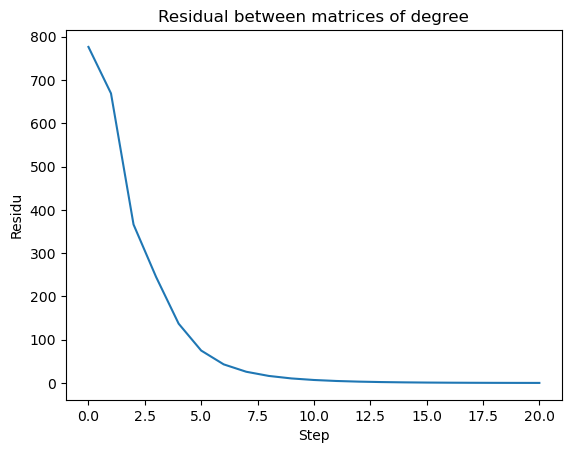


************** Step 22 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:14<00:00, 2797.76it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


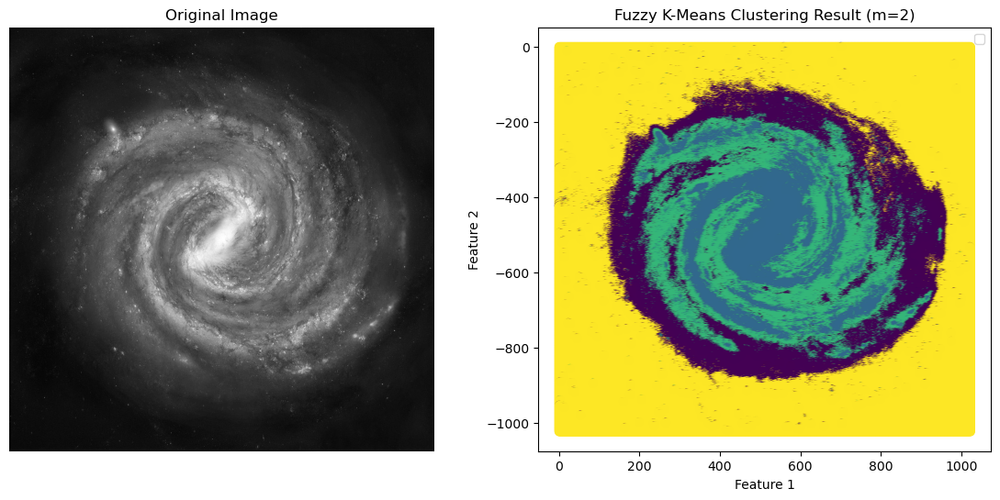

Done updating membership
## Showing result for 10000 - old; (0.02458457070845068,0.003457726846179318),new: (0.02458359893852459,0.0034578621092339642)

======> Computing centers...
Old centers: [ 61.48884519 137.28966802  98.01804856  23.26272868]
New centers: [ 61.49124919 137.29259365  98.02062679  23.26301197]
======> Computing distance between old and new degree of membership matrices...
Distance at step 22: 0.10576278013573517
======> Checking stopping condition


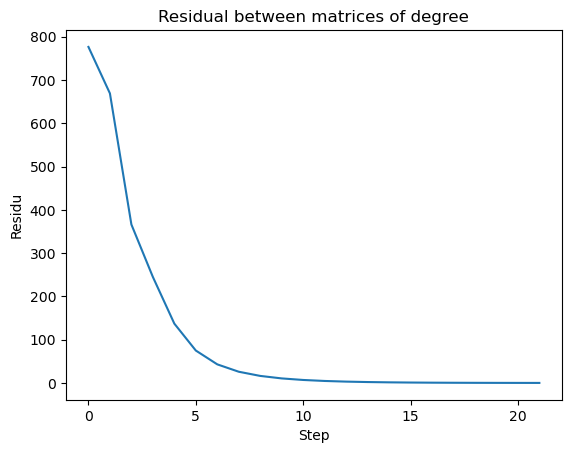


************** Step 23 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2807.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


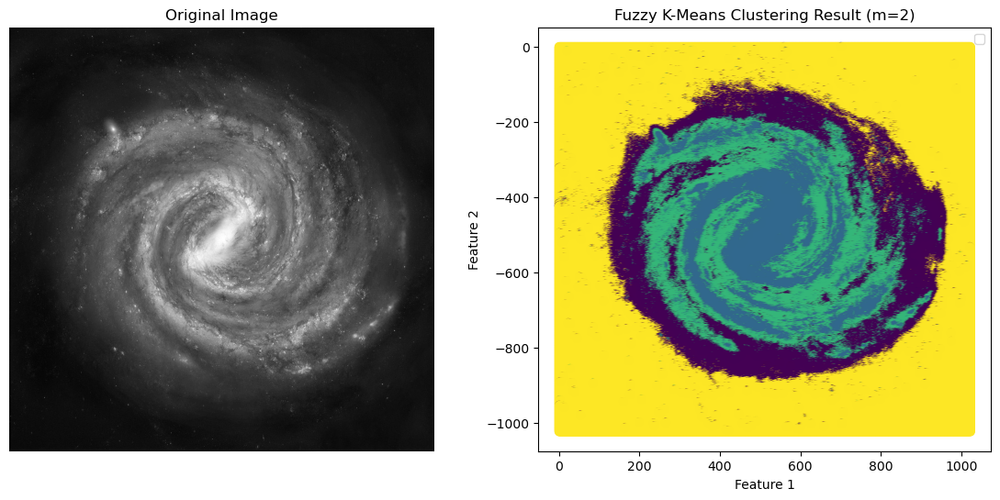

Done updating membership
## Showing result for 10000 - old; (0.02458359893852459,0.0034578621092339642),new: (0.02458292975847929,0.0034579666458158654)

======> Computing centers...
Old centers: [ 61.49124919 137.29259365  98.02062679  23.26301197]
New centers: [ 61.49293498 137.29456735  98.02240174  23.2632119 ]
======> Computing distance between old and new degree of membership matrices...
Distance at step 23: 0.07303021826026203
======> Checking stopping condition


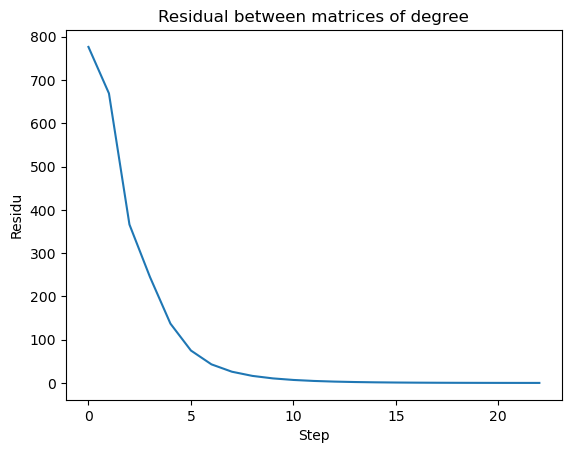


************** Step 24 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:16<00:00, 2781.73it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


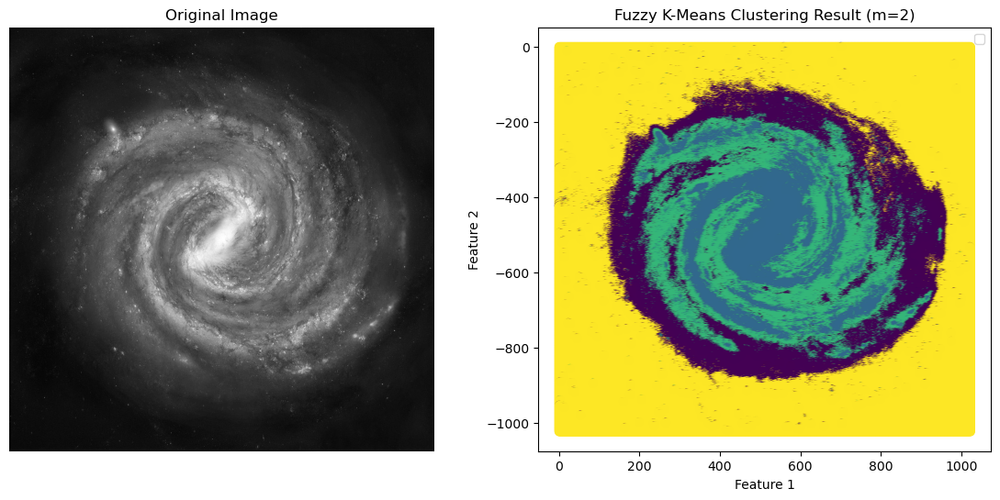

Done updating membership
## Showing result for 10000 - old; (0.02458292975847929,0.0034579666458158654),new: (0.024582468665988736,0.003458045532230614)

======> Computing centers...
Old centers: [ 61.49293498 137.29456735  98.02240174  23.2632119 ]
New centers: [ 61.49411474 137.29590255  98.02362415  23.26335258]
======> Computing distance between old and new degree of membership matrices...
Distance at step 24: 0.05044182525584937
======> Checking stopping condition


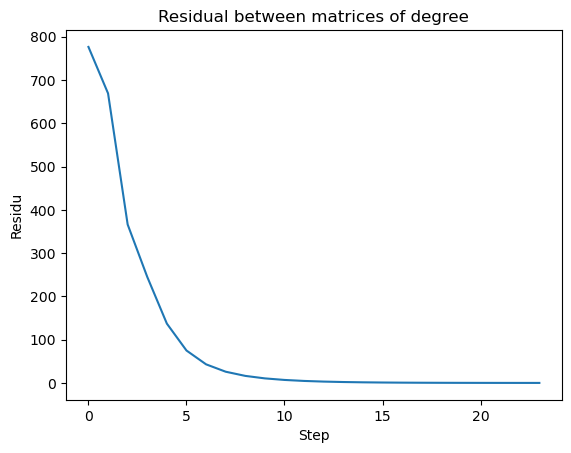


************** Step 25 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:20<00:00, 2759.24it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


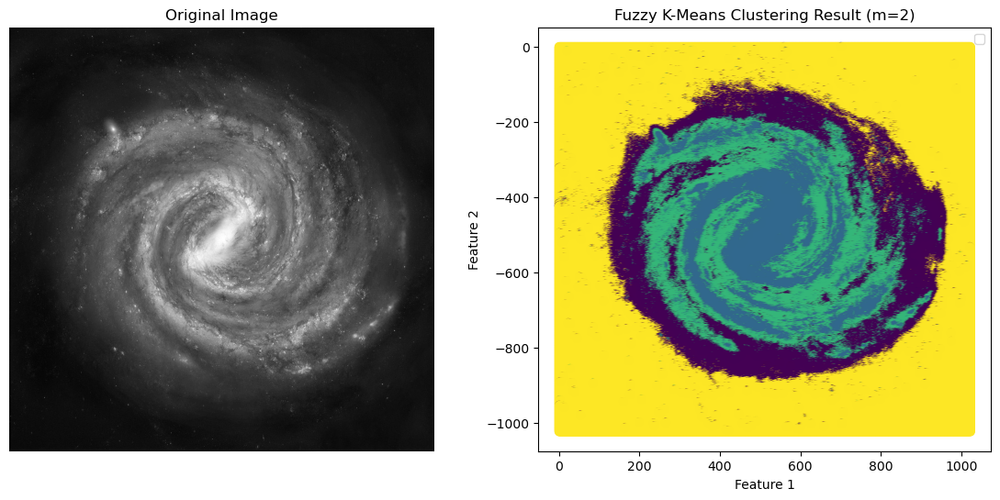

Done updating membership
## Showing result for 10000 - old; (0.024582468665988736,0.003458045532230614),new: (0.02458215080020567,0.003458104038510845)

======> Computing centers...
Old centers: [ 61.49411474 137.29590255  98.02362415  23.26335258]
New centers: [ 61.49493894 137.29680806  98.02446635  23.26345131]
======> Computing distance between old and new degree of membership matrices...
Distance at step 25: 0.03484680509609672
======> Checking stopping condition


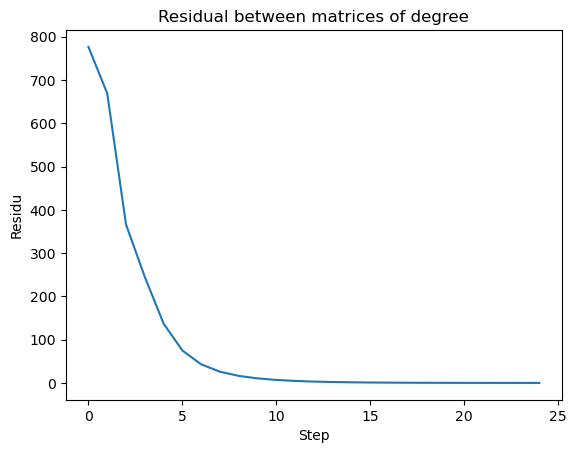


************** Step 26 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:14<00:00, 2801.23it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


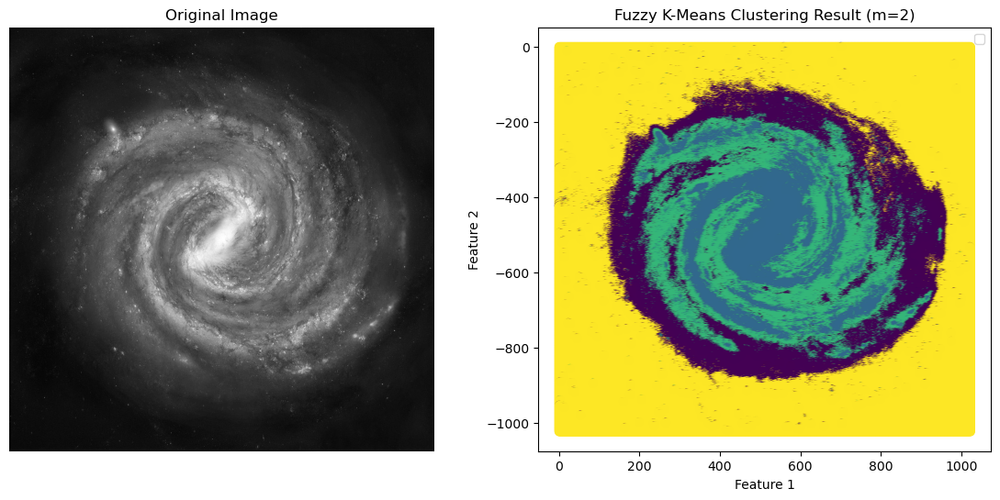

Done updating membership
## Showing result for 10000 - old; (0.02458215080020567,0.003458104038510845),new: (0.02458193158604186,0.0034581468662151543)

======> Computing centers...
Old centers: [ 61.49493894 137.29680806  98.02446635  23.26345131]
New centers: [ 61.49551387 137.29742352  98.02504679  23.26352045]
======> Computing distance between old and new degree of membership matrices...
Distance at step 26: 0.024076537029667062
======> Checking stopping condition


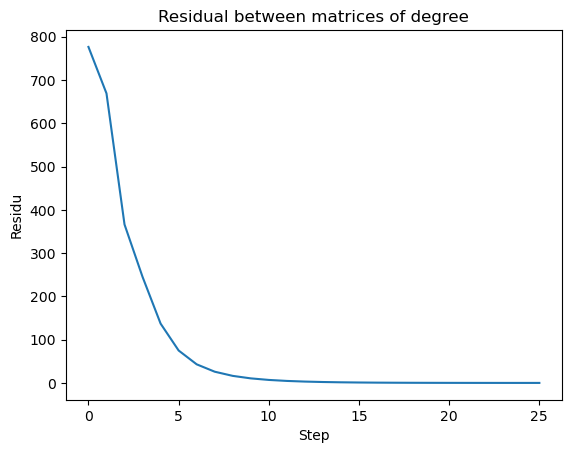


************** Step 27 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:19<00:00, 2762.99it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


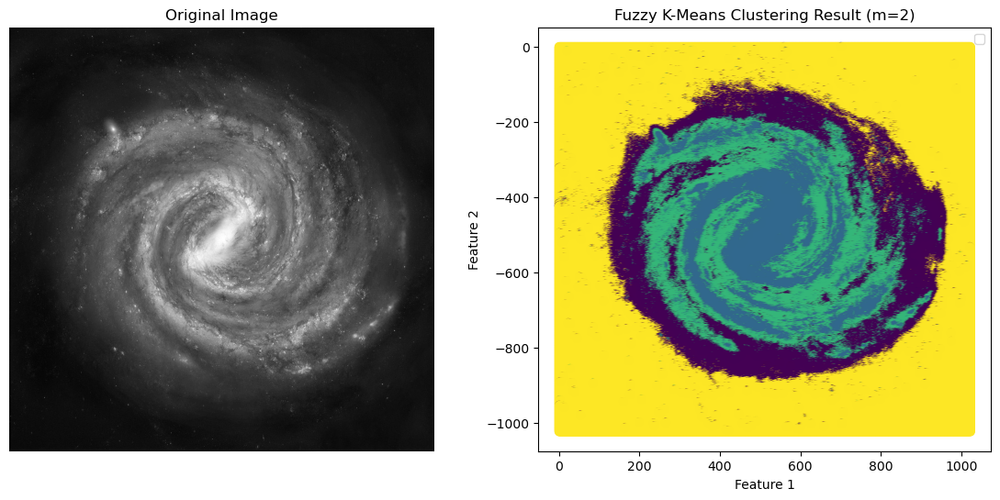

Done updating membership
## Showing result for 10000 - old; (0.02458193158604186,0.0034581468662151543),new: (0.02458178035852031,0.0034581779013215944)

======> Computing centers...
Old centers: [ 61.49551387 137.29742352  98.02504679  23.26352045]
New centers: [ 61.49591441 137.29784267  98.02544696  23.26356877]
======> Computing distance between old and new degree of membership matrices...
Distance at step 27: 0.016636645289183884
======> Checking stopping condition


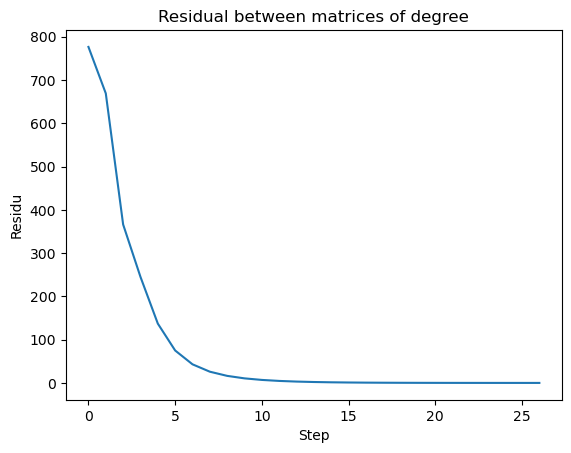


************** Step 28 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:11<00:00, 2826.16it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


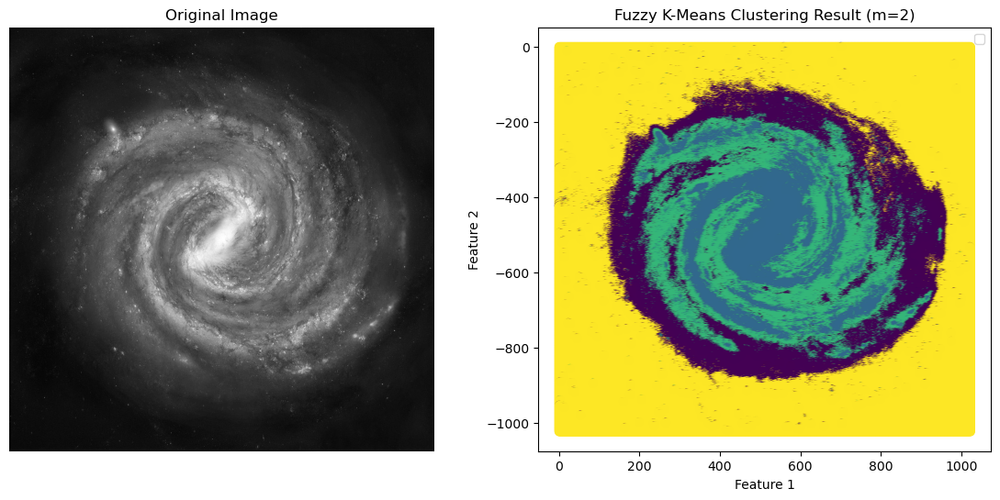

Done updating membership
## Showing result for 10000 - old; (0.02458178035852031,0.0034581779013215944),new: (0.024581676005367176,0.0034582002119464125)

======> Computing centers...
Old centers: [ 61.49591441 137.29784267  98.02544696  23.26356877]
New centers: [ 61.49619315 137.29812862  98.02572292  23.26360249]
======> Computing distance between old and new degree of membership matrices...
Distance at step 28: 0.011496484170838707
======> Checking stopping condition


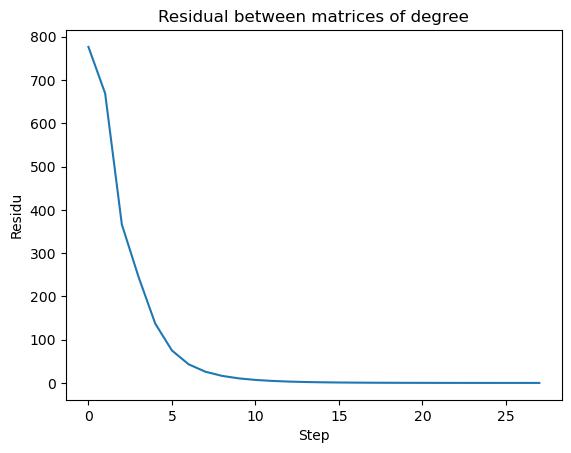


************** Step 29 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2817.54it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


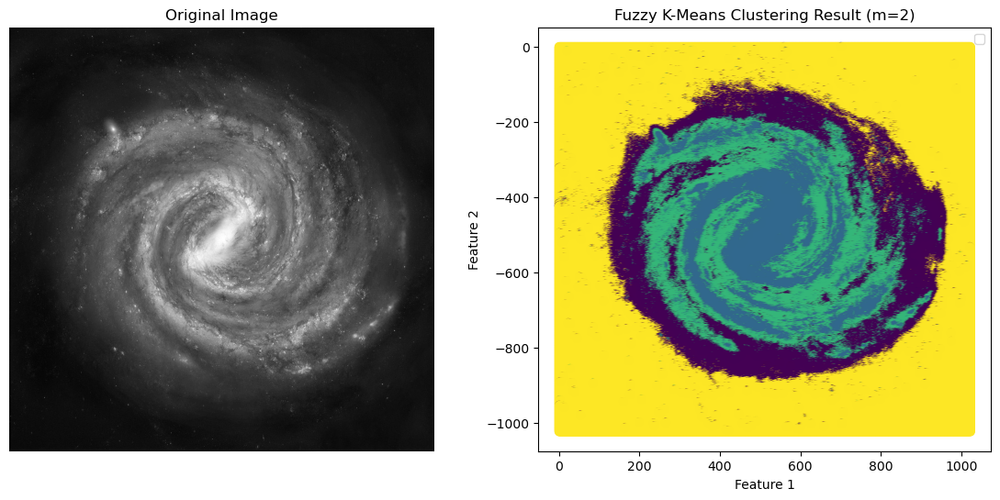

Done updating membership
## Showing result for 10000 - old; (0.024581676005367176,0.0034582002119464125),new: (0.024581603981949723,0.0034582161481791574)

======> Computing centers...
Old centers: [ 61.49619315 137.29812862  98.02572292  23.26360249]
New centers: [ 61.49638694 137.29832402  98.02591328  23.263626  ]
======> Computing distance between old and new degree of membership matrices...
Distance at step 29: 0.0079447902852147
======> Checking stopping condition


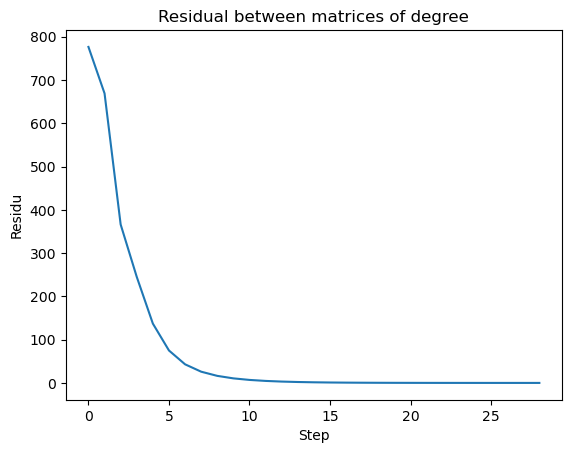


************** Step 30 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:11<00:00, 2819.96it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


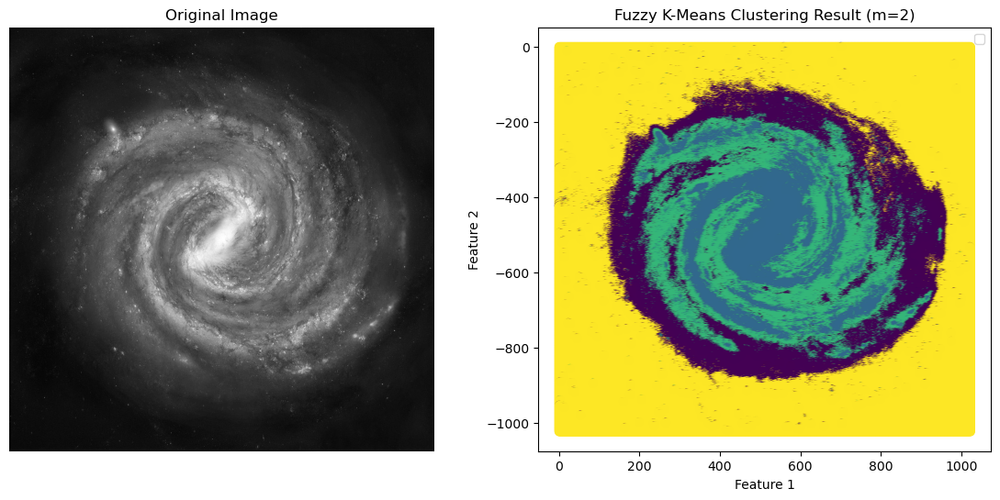

Done updating membership
## Showing result for 10000 - old; (0.024581603981949723,0.0034582161481791574),new: (0.02458155426329865,0.0034582274720887374)

======> Computing centers...
Old centers: [ 61.49638694 137.29832402  98.02591328  23.263626  ]
New centers: [ 61.49652155 137.29845772  98.02604461  23.26364235]
======> Computing distance between old and new degree of membership matrices...
Distance at step 30: 0.0054904914198744765
======> Checking stopping condition


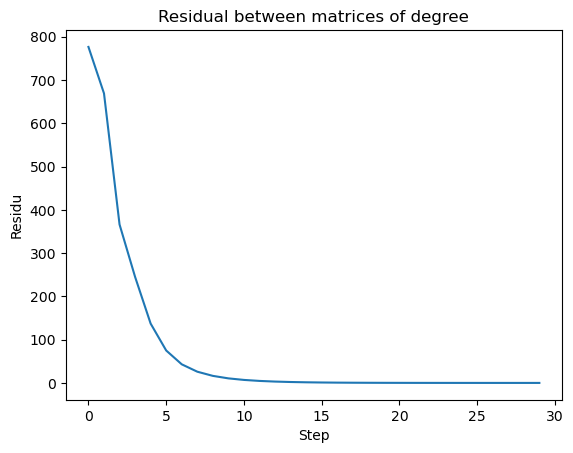


************** Step 31 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2809.30it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


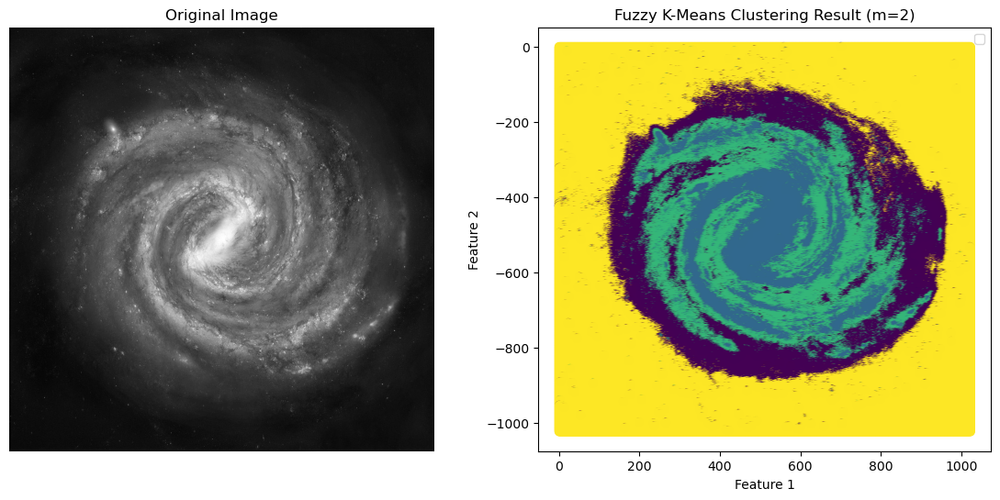

Done updating membership
## Showing result for 10000 - old; (0.02458155426329865,0.0034582274720887374),new: (0.024581519936671552,0.003458235484218517)

======> Computing centers...
Old centers: [ 61.49652155 137.29845772  98.02604461  23.26364235]
New centers: [ 61.496615   137.29854932  98.02613525  23.26365373]
======> Computing distance between old and new degree of membership matrices...
Distance at step 31: 0.003794431341583389
======> Checking stopping condition


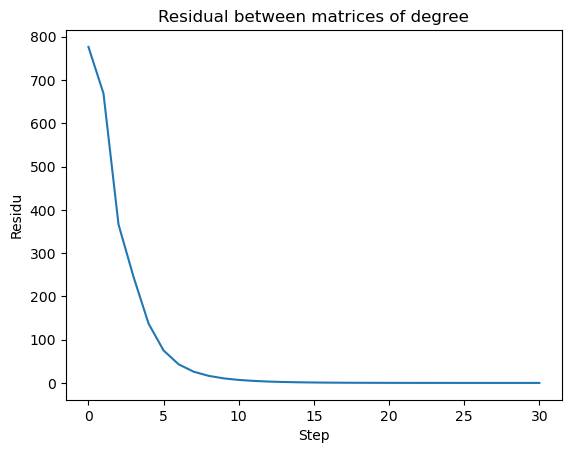


************** Step 32 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2816.61it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


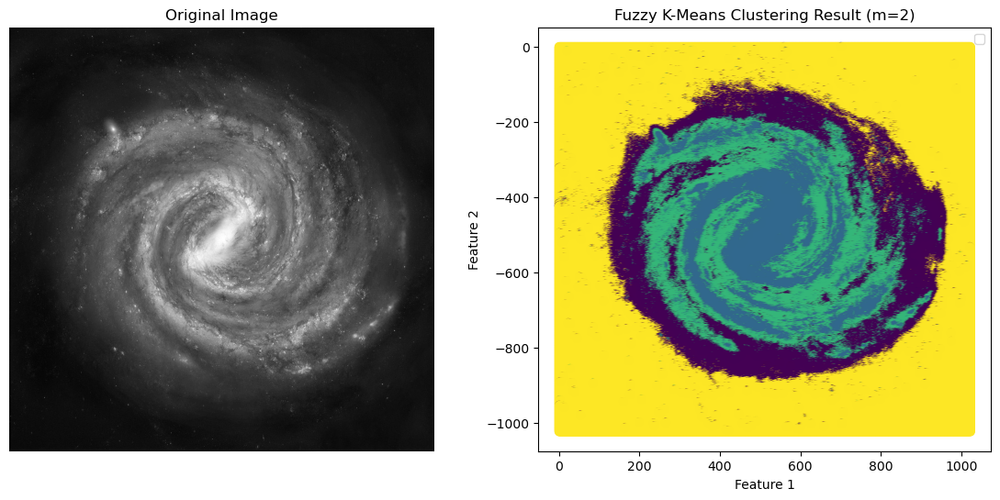

Done updating membership
## Showing result for 10000 - old; (0.024581519936671552,0.003458235484218517),new: (0.02458149623403866,0.0034582411330746888)

======> Computing centers...
Old centers: [ 61.496615   137.29854932  98.02613525  23.26365373]
New centers: [ 61.49667983 137.29861214  98.0261978   23.26366163]
======> Computing distance between old and new degree of membership matrices...
Distance at step 32: 0.002622318831412553
======> Checking stopping condition


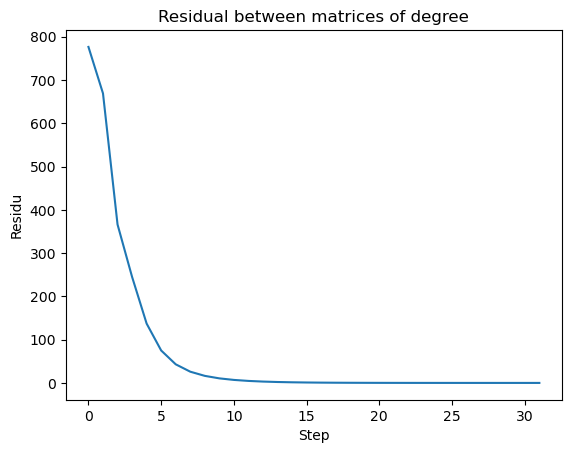


************** Step 33 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2810.31it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


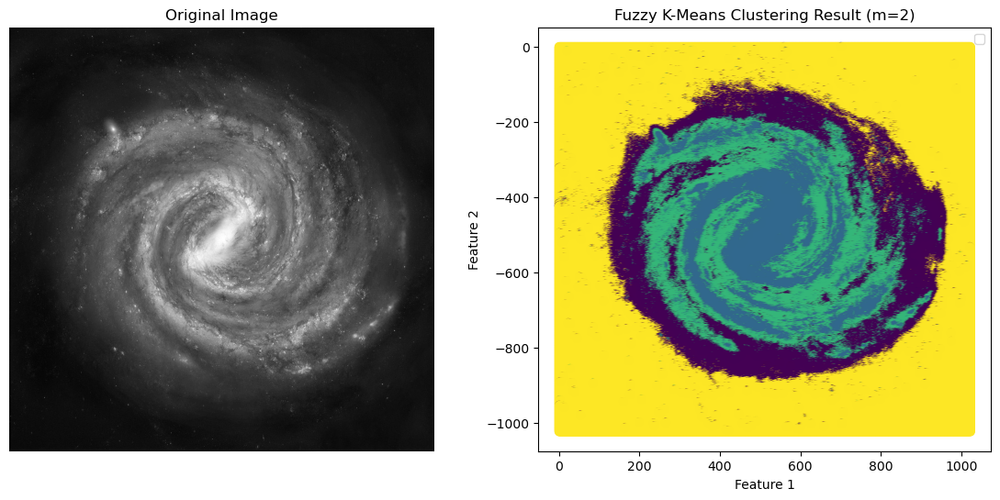

Done updating membership
## Showing result for 10000 - old; (0.02458149623403866,0.0034582411330746888),new: (0.02458147986543303,0.003458245103957153)

======> Computing centers...
Old centers: [ 61.49667983 137.29861214  98.0261978   23.26366163]
New centers: [ 61.49672479 137.29865526  98.02624099  23.26366712]
======> Computing distance between old and new degree of membership matrices...
Distance at step 33: 0.0018122805043708113
======> Checking stopping condition


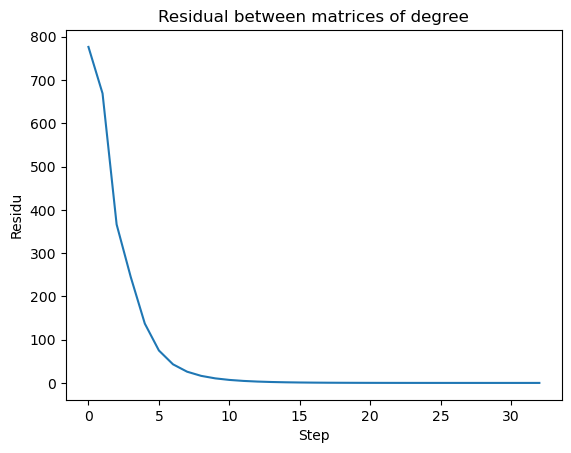


************** Step 34 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2808.42it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


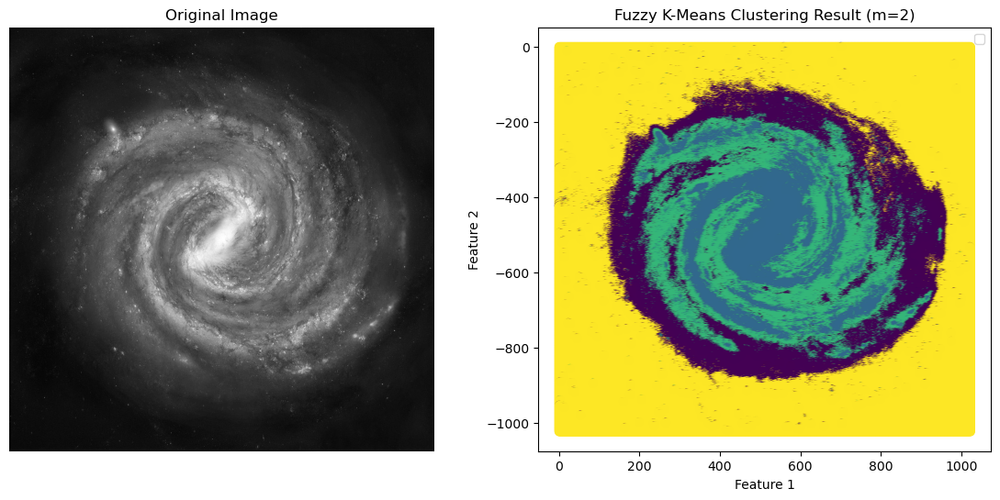

Done updating membership
## Showing result for 10000 - old; (0.02458147986543303,0.003458245103957153),new: (0.024581468560606876,0.0034582478883939042)

======> Computing centers...
Old centers: [ 61.49672479 137.29865526  98.02624099  23.26366712]
New centers: [ 61.49675594 137.29868489  98.0262708   23.26367093]
======> Computing distance between old and new degree of membership matrices...
Distance at step 34: 0.0012524630163385127
======> Checking stopping condition


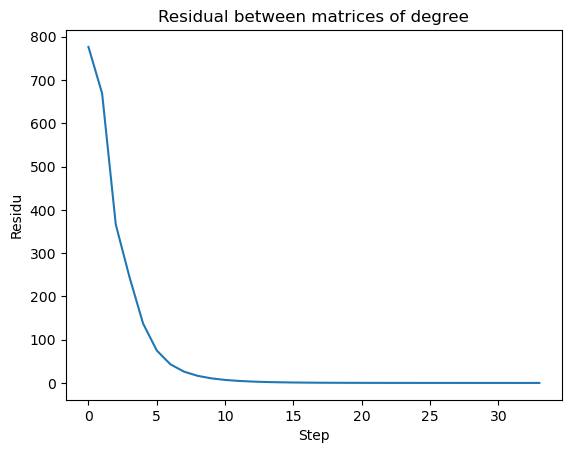


************** Step 35 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2805.27it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


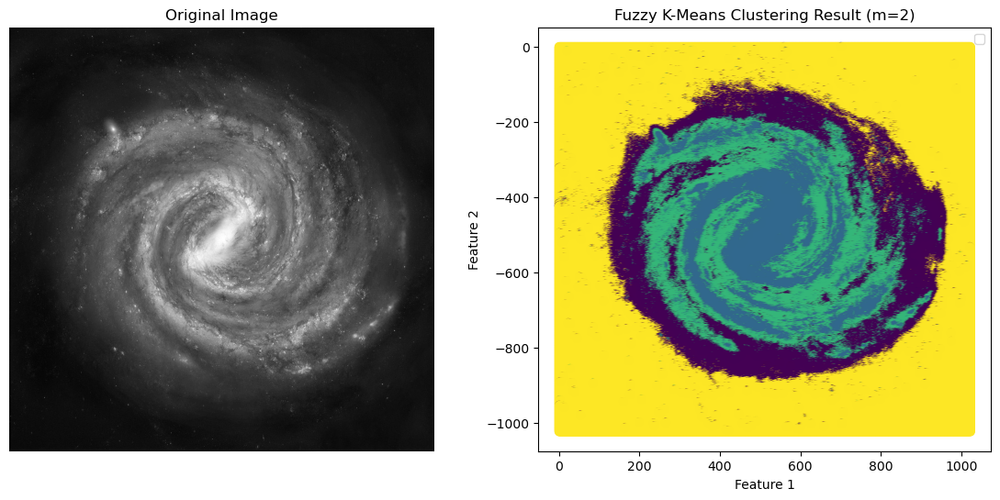

Done updating membership
## Showing result for 10000 - old; (0.024581468560606876,0.0034582478883939042),new: (0.024581460752426527,0.0034582498367981052)

======> Computing centers...
Old centers: [ 61.49675594 137.29868489  98.0262708   23.26367093]
New centers: [ 61.49677753 137.29870526  98.02629139  23.26367357]
======> Computing distance between old and new degree of membership matrices...
Distance at step 35: 0.0008655717660522255
======> Checking stopping condition


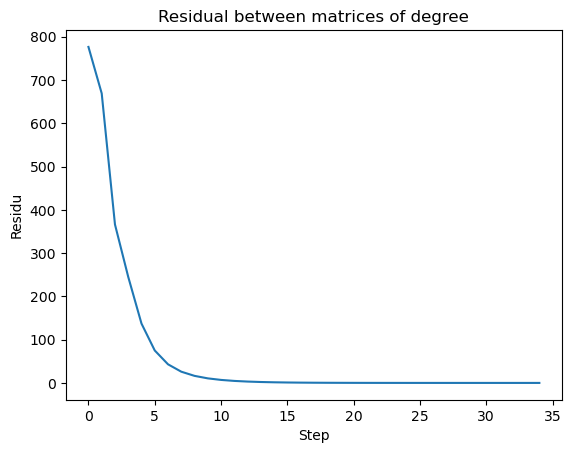


************** Step 36 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2811.29it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


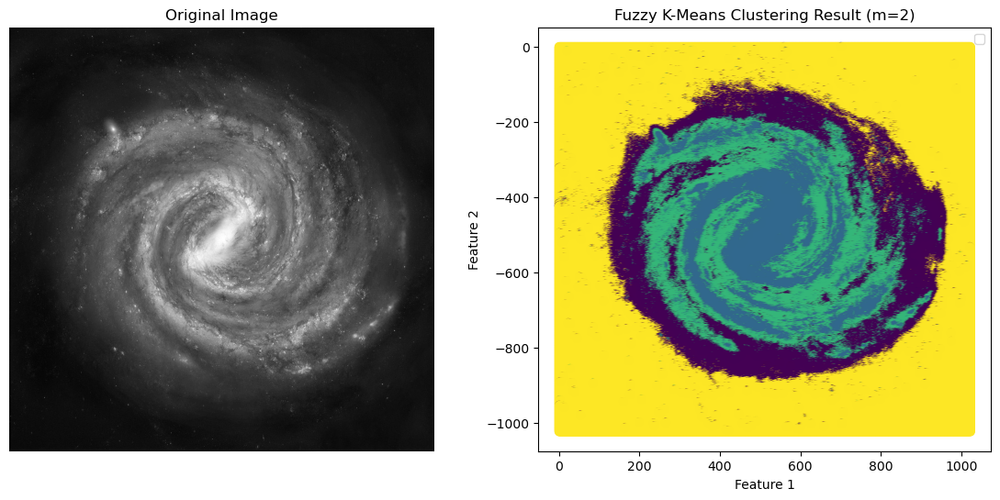

Done updating membership
## Showing result for 10000 - old; (0.024581460752426527,0.0034582498367981052),new: (0.024581455358952436,0.0034582511977684213)

======> Computing centers...
Old centers: [ 61.49677753 137.29870526  98.02629139  23.26367357]
New centers: [ 61.49679248 137.29871928  98.0263056   23.2636754 ]
======> Computing distance between old and new degree of membership matrices...
Distance at step 36: 0.0005981901323417414
======> Checking stopping condition


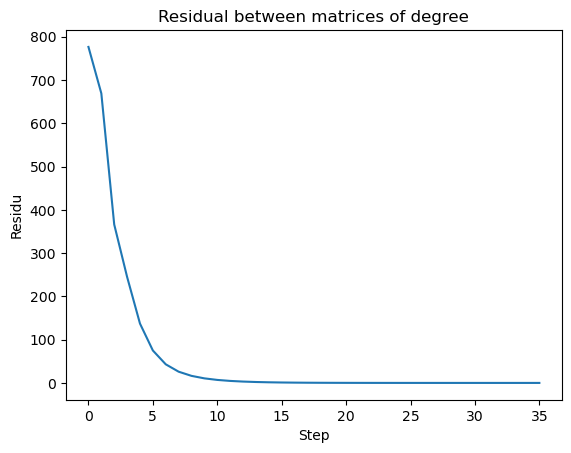


************** Step 37 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2809.86it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


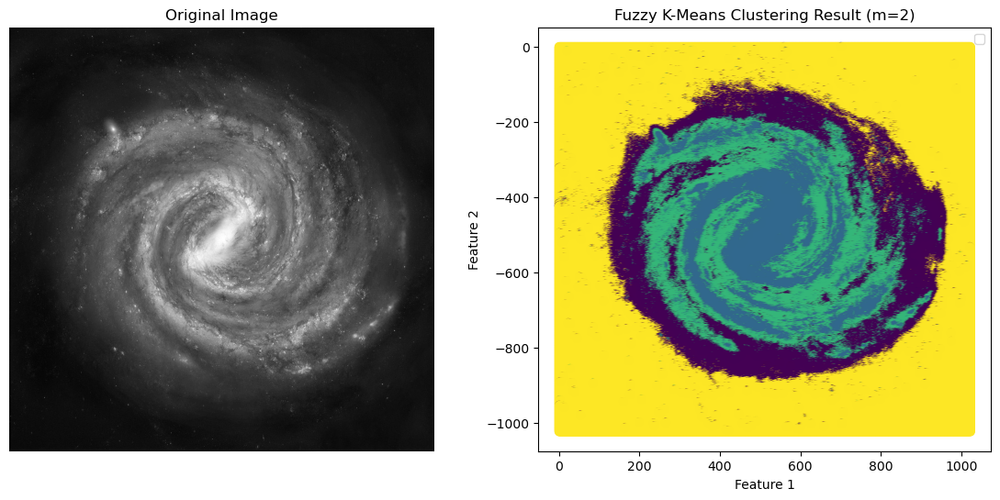

Done updating membership
## Showing result for 10000 - old; (0.024581455358952436,0.0034582511977684213),new: (0.024581451633198054,0.0034582521469793894)

======> Computing centers...
Old centers: [ 61.49679248 137.29871928  98.0263056   23.2636754 ]
New centers: [ 61.49680283 137.29872893  98.02631542  23.26367667]
======> Computing distance between old and new degree of membership matrices...
Distance at step 37: 0.0004134026412639356
======> Checking stopping condition


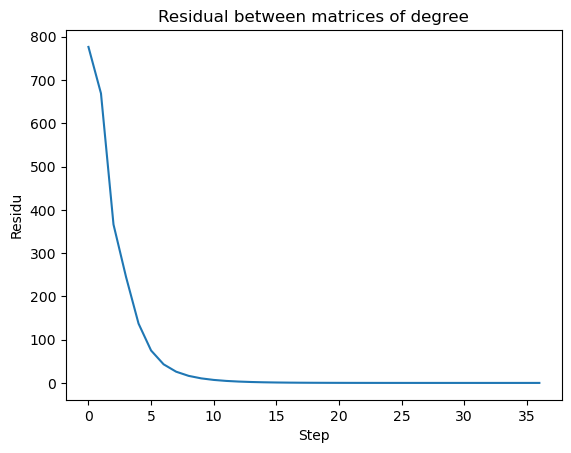


************** Step 38 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2813.02it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


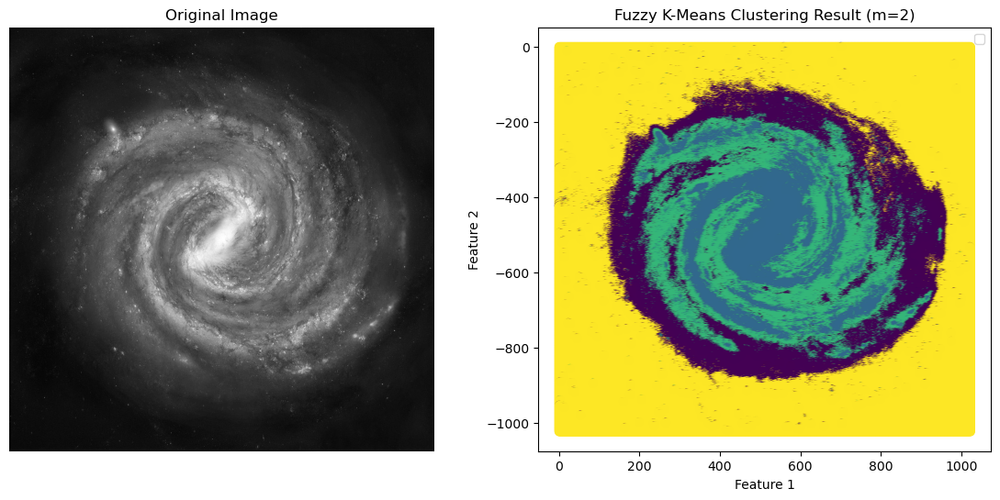

Done updating membership
## Showing result for 10000 - old; (0.024581451633198054,0.0034582521469793894),new: (0.024581449059404077,0.0034582528081683645)

======> Computing centers...
Old centers: [ 61.49680283 137.29872893  98.02631542  23.26367667]
New centers: [ 61.49680999 137.29873558  98.0263222   23.26367755]
======> Computing distance between old and new degree of membership matrices...
Distance at step 38: 0.0002856965505120755
======> Checking stopping condition


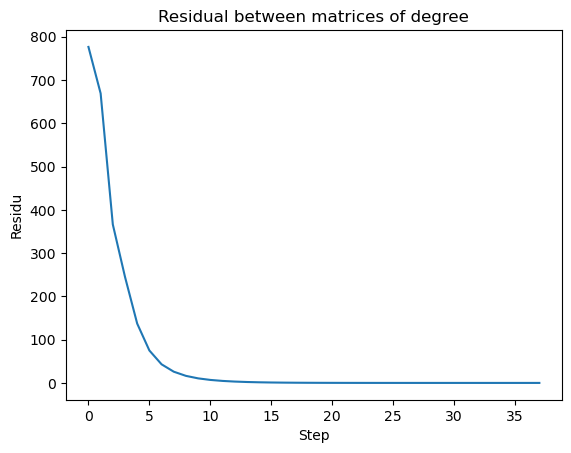


************** Step 39 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2812.21it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


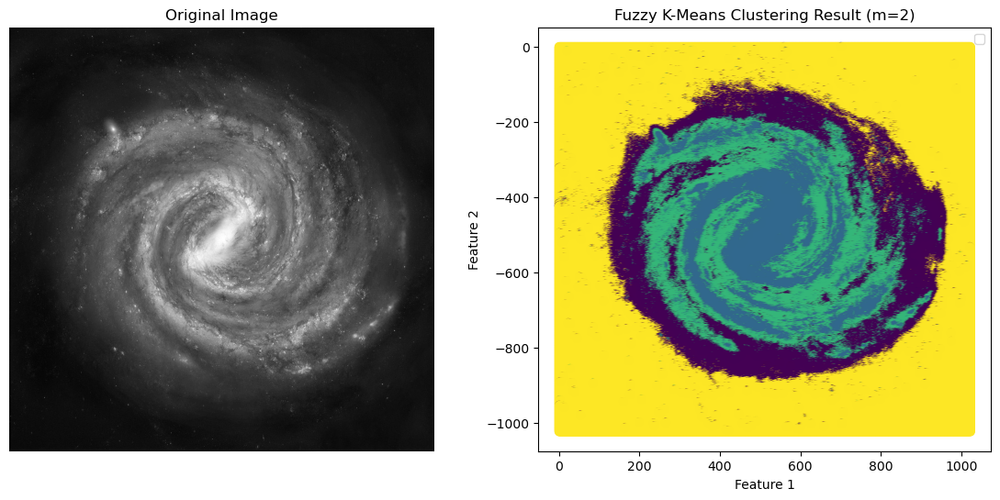

Done updating membership
## Showing result for 10000 - old; (0.024581449059404077,0.0034582528081683645),new: (0.024581447281267873,0.0034582532682155584)

======> Computing centers...
Old centers: [ 61.49680999 137.29873558  98.0263222   23.26367755]
New centers: [ 61.49681495 137.29874015  98.02632689  23.26367816]
======> Computing distance between old and new degree of membership matrices...
Distance at step 39: 0.0001974394621983205
======> Checking stopping condition


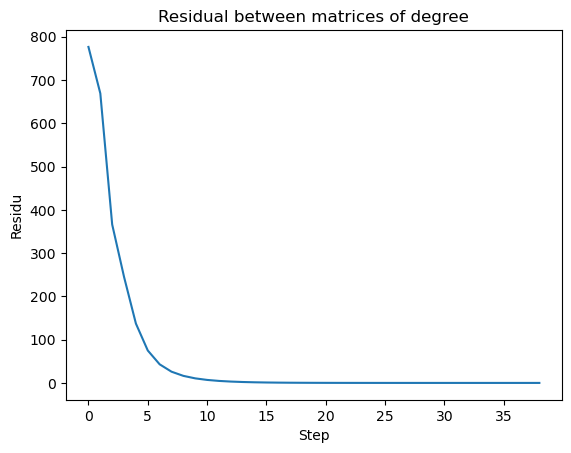


************** Step 40 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:13<00:00, 2807.33it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


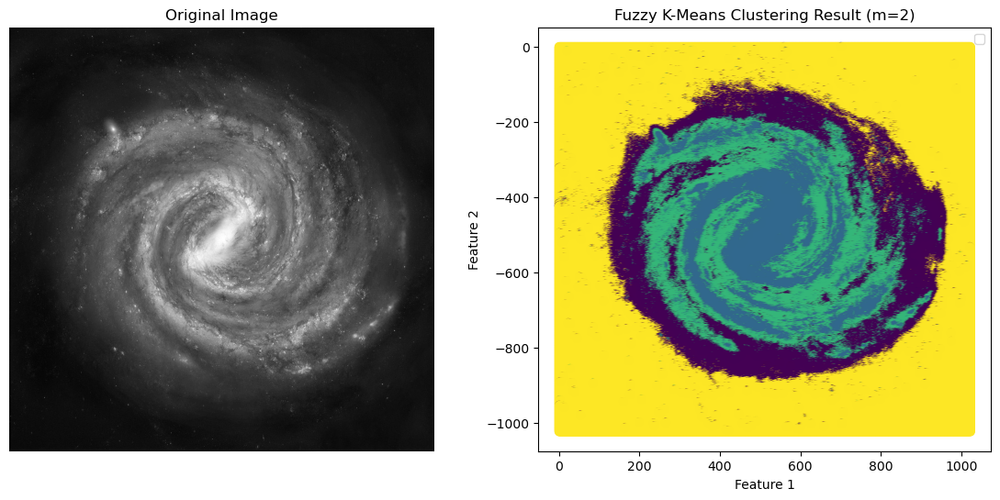

Done updating membership
## Showing result for 10000 - old; (0.024581447281267873,0.0034582532682155584),new: (0.02458144605284397,0.0034582535880204076)

======> Computing centers...
Old centers: [ 61.49681495 137.29874015  98.02632689  23.26367816]
New centers: [ 61.49681838 137.29874331  98.02633012  23.26367858]
======> Computing distance between old and new degree of membership matrices...
Distance at step 40: 0.00013644607244432617
======> Checking stopping condition


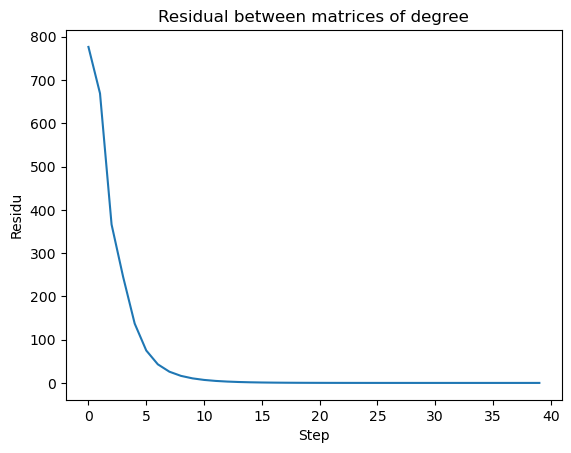


************** Step 41 **************

======> Updating degree of membership matrix...


100%|██████████| 1048576/1048576 [06:12<00:00, 2811.81it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


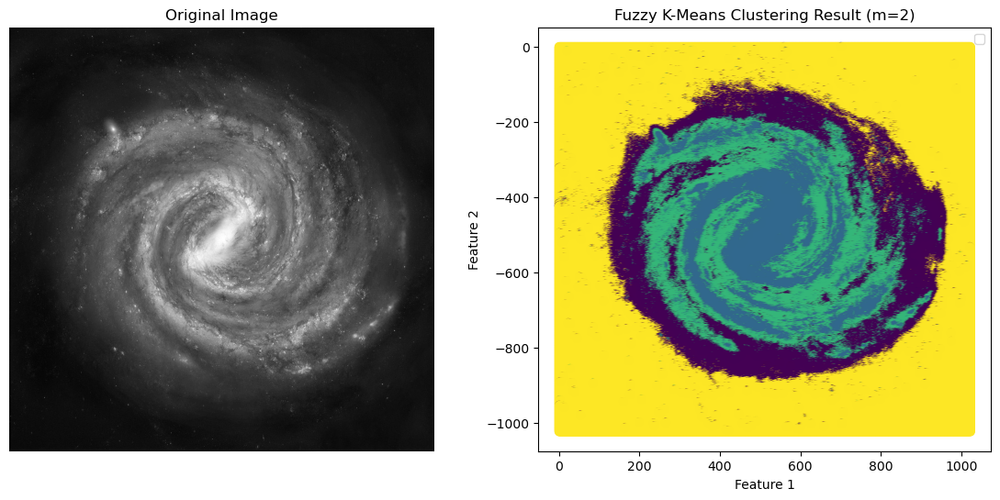

Done updating membership
## Showing result for 10000 - old; (0.02458144605284397,0.0034582535880204076),new: (0.024581445204084076,0.0034582538101452457)

======> Computing centers...
Old centers: [ 61.49681838 137.29874331  98.02633012  23.26367858]
New centers: [ 61.49682075 137.29874549  98.02633236  23.26367887]
======> Computing distance between old and new degree of membership matrices...
Distance at step 41: 9.429415962360898e-05
======> Checking stopping condition


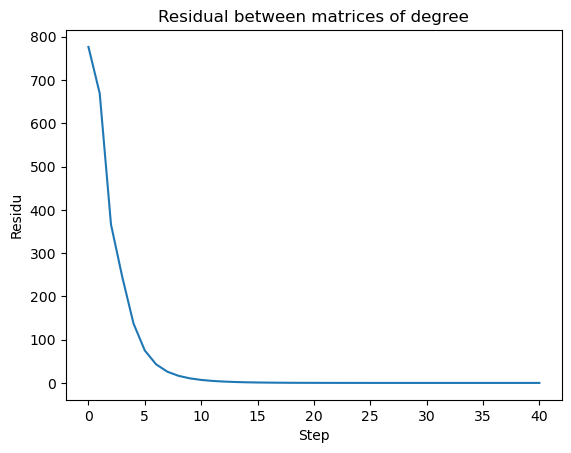

In [196]:
print("======> Preparing data...")
img_path_ = "./milky-way-nvg.jpg"
img_ = read_image(img_path_)
image_point_map_ = img_point_map(img_)
show_hist_img(img_)
centers_vectors_ = [30.56, 60.3, 45.5, 23.6]
m_ = 1000 # number of steps
fuzziness = 2
n_clusters = len(centers_vectors_)
membership_ = initialize_membership(img_, n_clusters, 'zeros')
eps = 1e-04
residu = []


for step in range(m_ - 1):
    print(f"\n************** Step {step + 1} **************")
    # update the membership matrix
    print(f"\n======> Updating degree of membership matrix...")
    new_membership_ = update_membership(membership_, centers_vectors_, fuzziness, img_, image_point_map_)
    visualize_fuzzy_k_means_result(new_membership_, centers_vectors_, fuzziness, img_, image_point_map_)
    print("Done updating membership")

    val = 10000
    print(f"## Showing result for {val} - old; ({membership_.iloc[val][0]},{membership_.iloc[val][1]}),"\
          f"new: ({new_membership_.iloc[val][0]},{new_membership_.iloc[val][1]})")

    # calculate the center vector
    print("\n======> Computing centers...")
    print(f"Old centers: {centers_vectors_}")
    centers_vectors_ = compute_center_vector(new_membership_,img_, image_point_map_)
    print(f"New centers: {centers_vectors_}")

    # compute distance between old and new membership
    print("======> Computing distance between old and new degree of membership matrices...")
    dst = distance(new_membership_, membership_)
    membership_ = new_membership_
    residu.append(dst)
    print(f"Distance at step {step + 1}: {dst}")

    # verifying stopping condition
    print(f"======> Checking stopping condition")
    if len(residu) > 1:
        plt.plot(residu)
        plt.xlabel('Step')
        plt.ylabel('Residu')
        plt.title('Residual between matrices of degree')
        plt.show()

    if dst < eps:
        break